# Clustering of NR Clean data
* continuing from 2024-11-08_Clean-data-integration.jpynb
* clustering, visualising and annotating of Nikita clean data (containing just macs and DCs)

# Set up workspace:

In [1]:
#load packages I need
import os
import tools
import scanpy as sc
import pandas as pd
import dandelion as ddl
from tqdm import tqdm
import matplotlib.pyplot as plt
import scanpy.external as sce
from matplotlib.pyplot import rc_context

In [2]:
#show current directory 
os.getcwd()
os.chdir('/scratch/user/s4436039/scdata/Python_Integration_Sep')
os.getcwd()

'/scratch/user/s4436039/scdata/Python_Integration_Sep'

Print software versions:

In [3]:
sc.logging.print_header()

scanpy==1.10.2 anndata==0.10.8 umap==0.5.6 numpy==1.26.4 scipy==1.14.0 pandas==2.2.2 scikit-learn==1.5.0 statsmodels==0.14.2 igraph==0.11.5 pynndescent==0.5.12


In [4]:
ddl.logging.print_header()

dandelion==0.3.8 pandas==2.2.2 numpy==1.26.4 matplotlib==3.9.2 networkx==3.3 scipy==1.14.0


Set plotting parameters

In [5]:
sc.settings.set_figure_params(dpi=80, facecolor="white")

In [49]:
# read in data
data = sc.read_h5ad('NRclean_post-int.h5ad')

In [50]:
data

AnnData object with n_obs × n_vars = 498382 × 1268
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden', 'celltype', 'leiden_DC', 'leiden_DC_v2', 'exclude_annots', 'leiden_M', 'Technology'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    varm: 'PCs'
    obsp: 'c

# Add in metadata column that has broader cancer_subtypes 
* (ie. grouping all the breast cancers together)

In [51]:
#make a column new to store broad cancer type
data.obs["cancer_type_broad"] = data.obs["cancer_subtype"]

In [52]:
unique_values = data.obs['cancer_type_broad'].unique().tolist()
print(unique_values)

['Acral Melanoma', 'Melanoma', 'TNBC', 'HNSCC', 'NSCLC', 'NA', 'HER2 Breast Cancer', 'ER Breast Cancer', 'HGSOC', 'Breast DCIS', 'Breast IDC', 'BRCA1 TNBC', 'PDAC', 'CRC', 'Breast Cancer', 'GBM', 'GAC', 'HCC', 'iCCA', 'NPC']


In [53]:
#make a copy of the data containing just the breast cancers 
breast = data[data.obs["cancer_subtype"].isin(["BRCA1 TNBC", "Breast Cancer", "Breast DCIS", "Breast IDC","ER Breast Cancer","HER2 Breast Cancer","TNBC"])]
#set all those in breast to Breast Cancer
breast.obs["cancer_type_broad"] = "Breast Cancer"

/scratch/temp/11499052/ipykernel_3824376/598791162.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.


In [54]:
#update the original object
data.obs["cancer_type_broad"].update(breast.obs["cancer_type_broad"]) 

/scratch/temp/11499052/ipykernel_3824376/3103835579.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.




In [55]:
unique_values = data.obs['cancer_type_broad'].unique().tolist()
print(unique_values)

['Acral Melanoma', 'Melanoma', 'Breast Cancer', 'HNSCC', 'NSCLC', 'NA', 'HGSOC', 'PDAC', 'CRC', 'GBM', 'GAC', 'HCC', 'iCCA', 'NPC']


In [56]:
unique_values = data.obs['cancer_subtype'].unique().tolist()
print(unique_values)

['Acral Melanoma', 'Melanoma', 'TNBC', 'HNSCC', 'NSCLC', 'NA', 'HER2 Breast Cancer', 'ER Breast Cancer', 'HGSOC', 'Breast DCIS', 'Breast IDC', 'BRCA1 TNBC', 'PDAC', 'CRC', 'Breast Cancer', 'GBM', 'GAC', 'HCC', 'iCCA', 'NPC']


In [57]:
#export updated object
data.write_h5ad("NRclean_clustered.h5ad", compression="gzip")

In [58]:
data

AnnData object with n_obs × n_vars = 498382 × 1268
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden', 'celltype', 'leiden_DC', 'leiden_DC_v2', 'exclude_annots', 'leiden_M', 'Technology', 'cancer_type_broad'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'log1p', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_pca_harmony', 'X_umap'
    var

# Perform clustering (1hr):
* Choosing excessively high resolution as want to break in to lots of clusters and then can score them all on gene sets and regroup clusters

### Clustering step was done by submitting a job. 

* Bashscript is named: _NR_bashscript-leiden2.sh
* python script named: _NR-script-leiden2.py

Ran with `sbatch _NR_bashscript-leiden2.sh`

Bashscript: 
``` bash
#!/bin/bash
#SBATCH --nodes=1
#SBATCH --ntasks-per-node=1
#SBATCH --cpus-per-task=64
#SBATCH --mem=200G
#SBATCH --job-name=NR-clean-leiden08
#SBATCH --time=4:00:00
#SBATCH --partition=general
#SBATCH --account=a_kelvin_tuong
#SBATCH -o NR-clean-leiden08.output
#SBATCH -e NR-clean-leiden08.error

# export JAVA_CMD=/home/uqztuong/miniforge3/bin/java
source ~/.bashrc
mamba activate env
python3 _NR-script-leiden2.py
```

Python script: 
``` python
import os
import tools
import scanpy as sc
import pandas as pd
import dandelion as ddl
from tqdm import tqdm
import matplotlib.pyplot as plt
import scanpy.external as sce

os.chdir('/scratch/user/s4436039/scdata/Python_Integration_Sep')

data = sc.read_h5ad("/scratch/user/s4436039/scdata/Python_Integration_Sep/NRclean_clustered.h5ad")

sc.tl.leiden(data, resolution=0.8, key_added='clean-leiden_0.8')

data.write_h5ad("/scratch/user/s4436039/scdata/Python_Integration_Sep/NRclean_clustered.h5ad", compression="gzip")
```

### took ~1hr

In [6]:
# read in data
data = sc.read_h5ad('NRclean_clustered.h5ad')

### Visualise clusters:

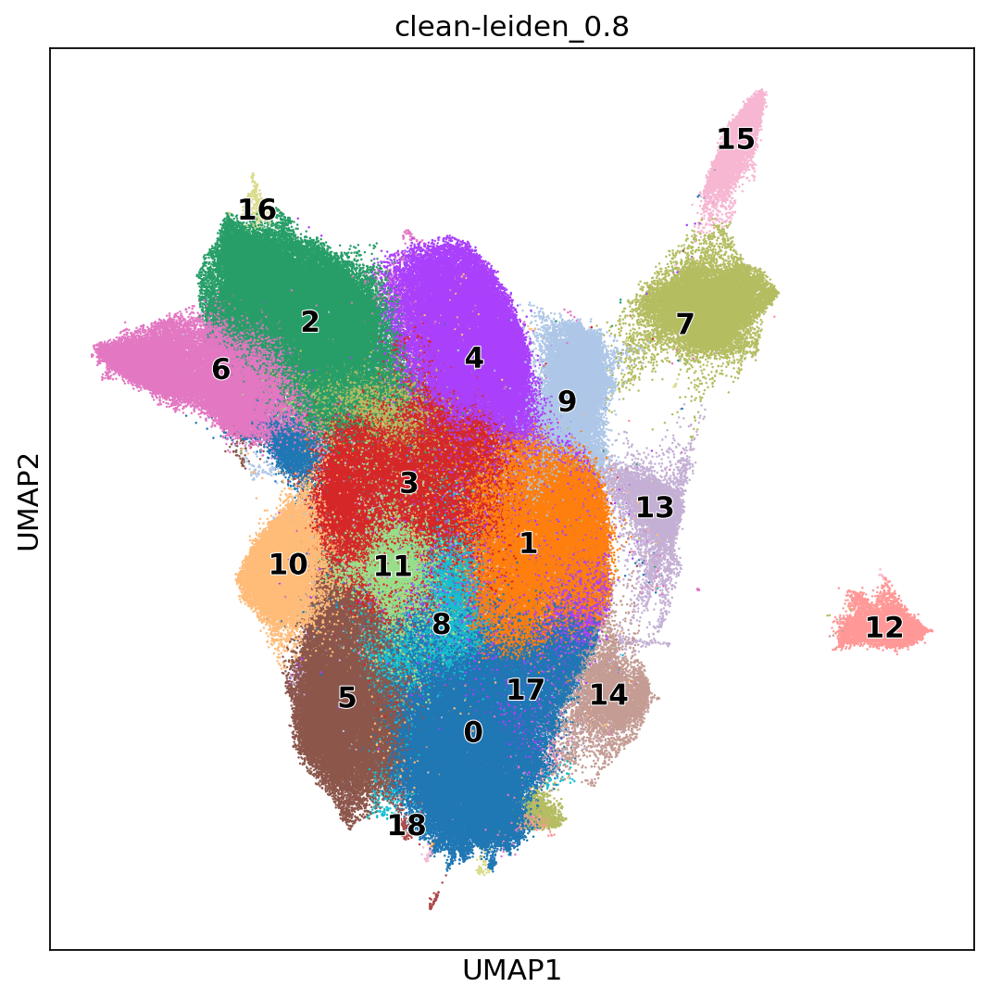

In [9]:
#plotting clusters
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color="clean-leiden_0.8", legend_loc="on data", legend_fontoutline=1, size=5)

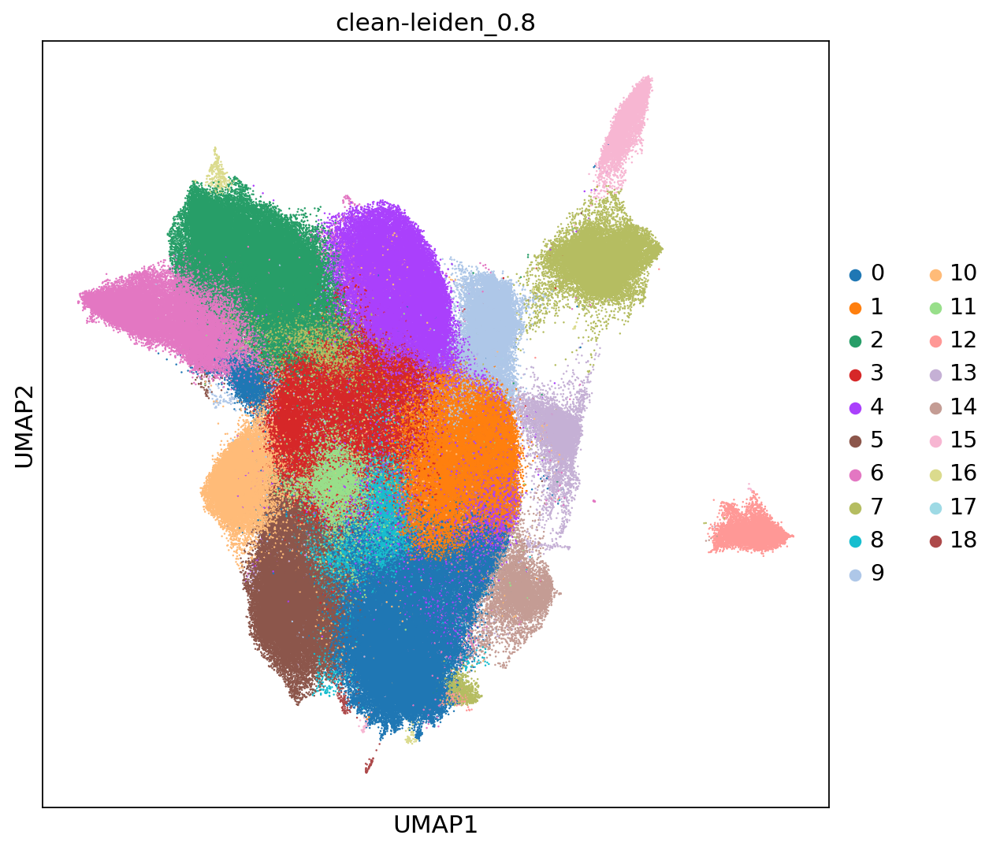

In [10]:
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color="clean-leiden_0.8", size=5)

### view each cluster seperately to see if any should be subclustered

In [11]:
#define function
def cluster_small_multiples(
    data_int, clust_key, size=5, frameon=False, legend_loc=None, **kwargs
):
    tmp = data_int.copy()

    for i, clust in enumerate(data_int.obs[clust_key].cat.categories):
        tmp.obs[clust] = data_int.obs[clust_key].isin([clust]).astype("category")
        tmp.uns[clust + "_colors"] = ["#d3d3d3", data_int.uns[clust_key + "_colors"][i]]

    sc.pl.umap(
        tmp,
        groups=tmp.obs[clust].cat.categories[1:].values,
        color=data_int.obs[clust_key].cat.categories.tolist(),
        size=size,
        frameon=frameon,
        legend_loc=legend_loc,
        **kwargs
    )

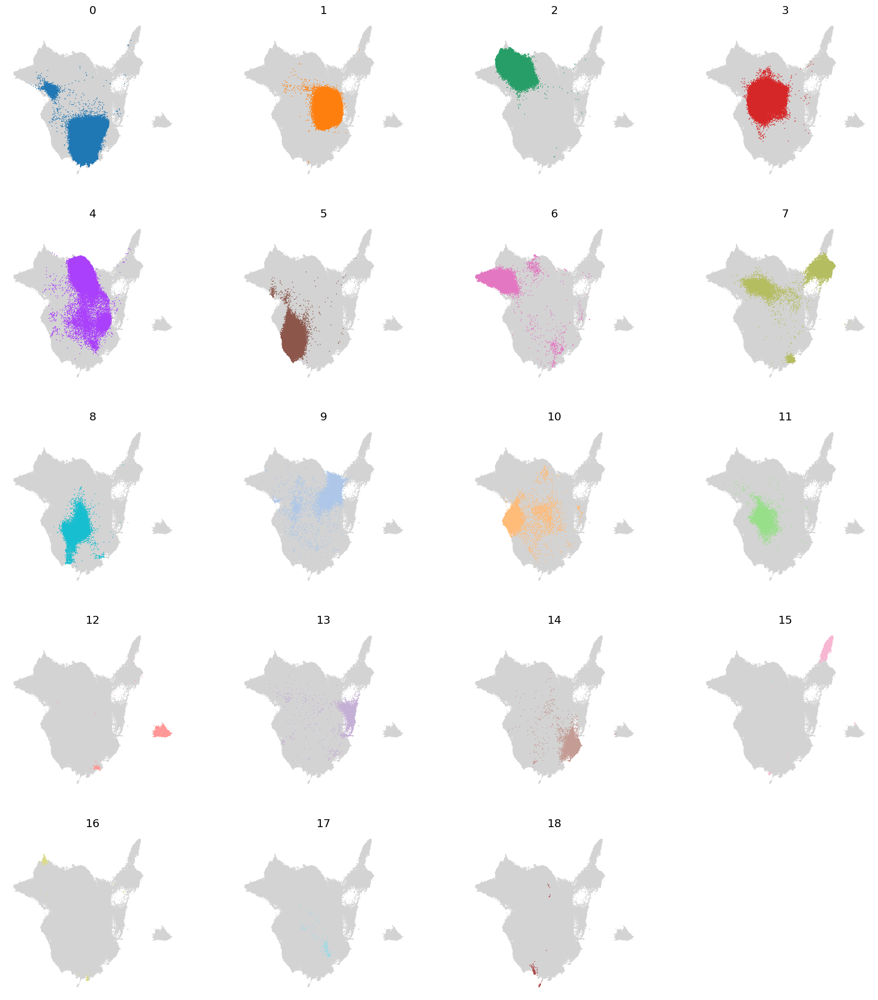

In [12]:
cluster_small_multiples(data, "clean-leiden_0.8")

### From this I want to subcluster clusters 0, 7, 12 further
* 0 doesn't split well
* 7 split in to 3 clusters

In [ ]:
#subcluster cluster 7
sc.tl.leiden(data, restrict_to=('clean-leiden_0.8', ['7']), resolution=0.1, key_added="clean-subcluster")

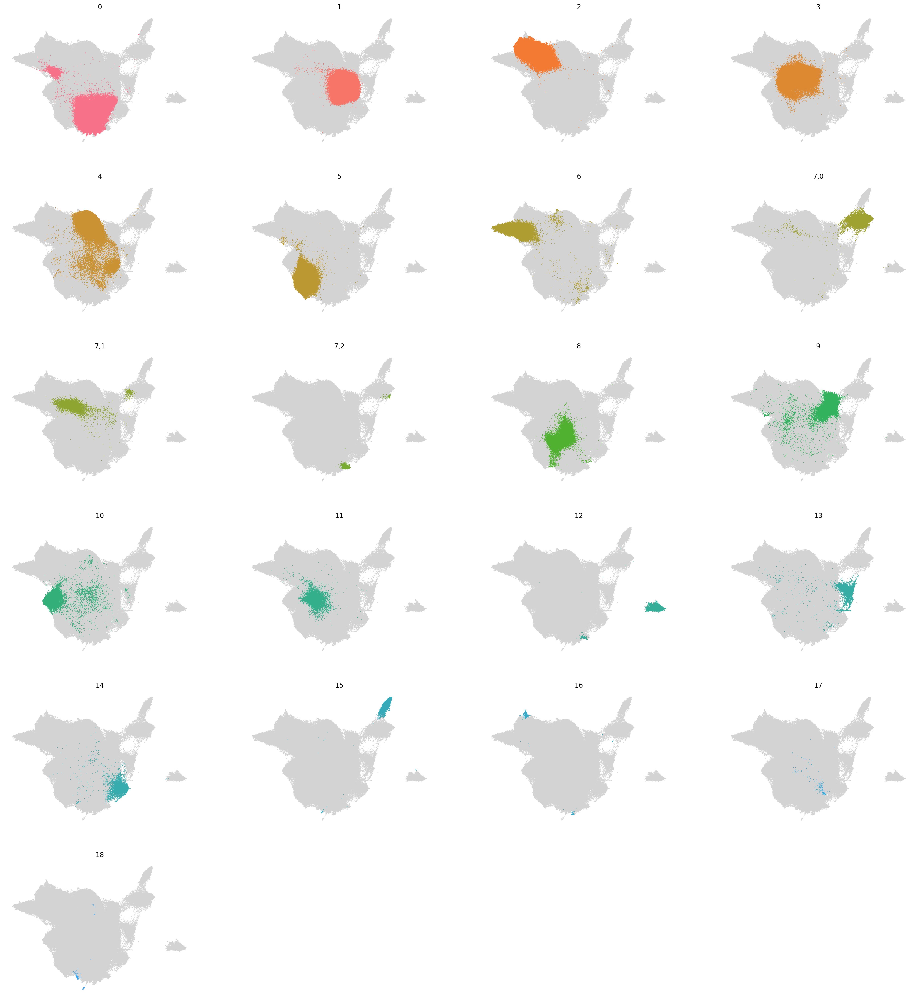

In [44]:
cluster_small_multiples(data, "clean-subcluster")

In [41]:
#subcluster cluster 12
sc.tl.leiden(data, restrict_to=('clean-subcluster', ['12']), resolution=0.2, key_added="clean-subcluster-v2")

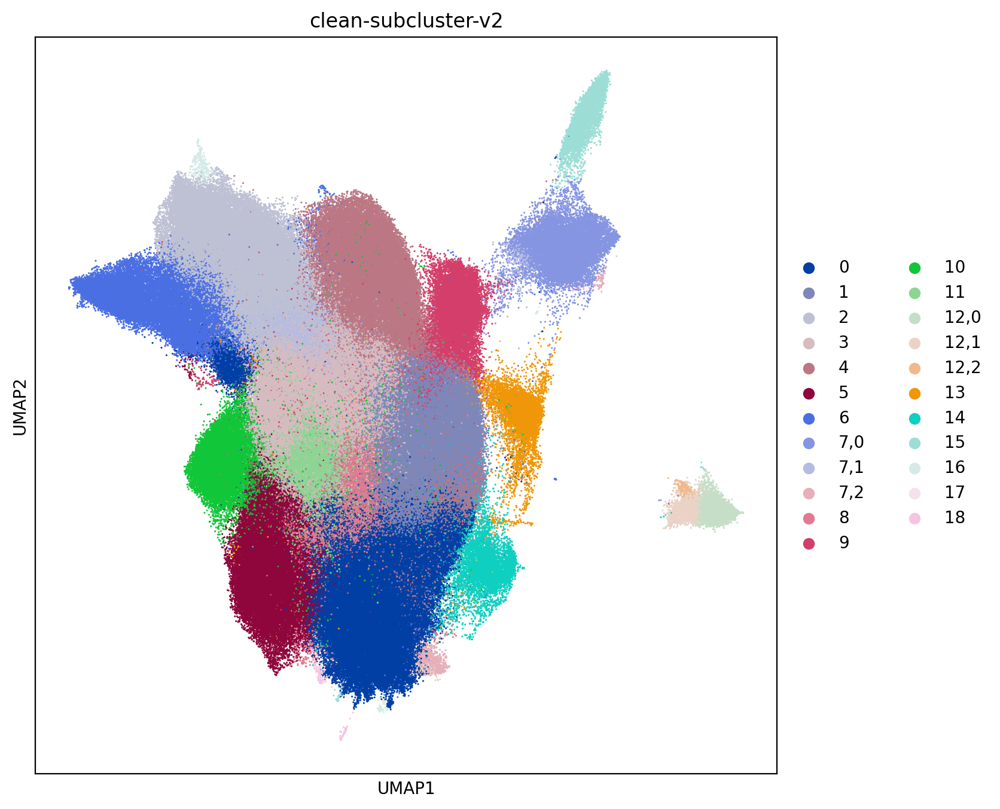

In [42]:
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color="clean-subcluster-v2", size=5)

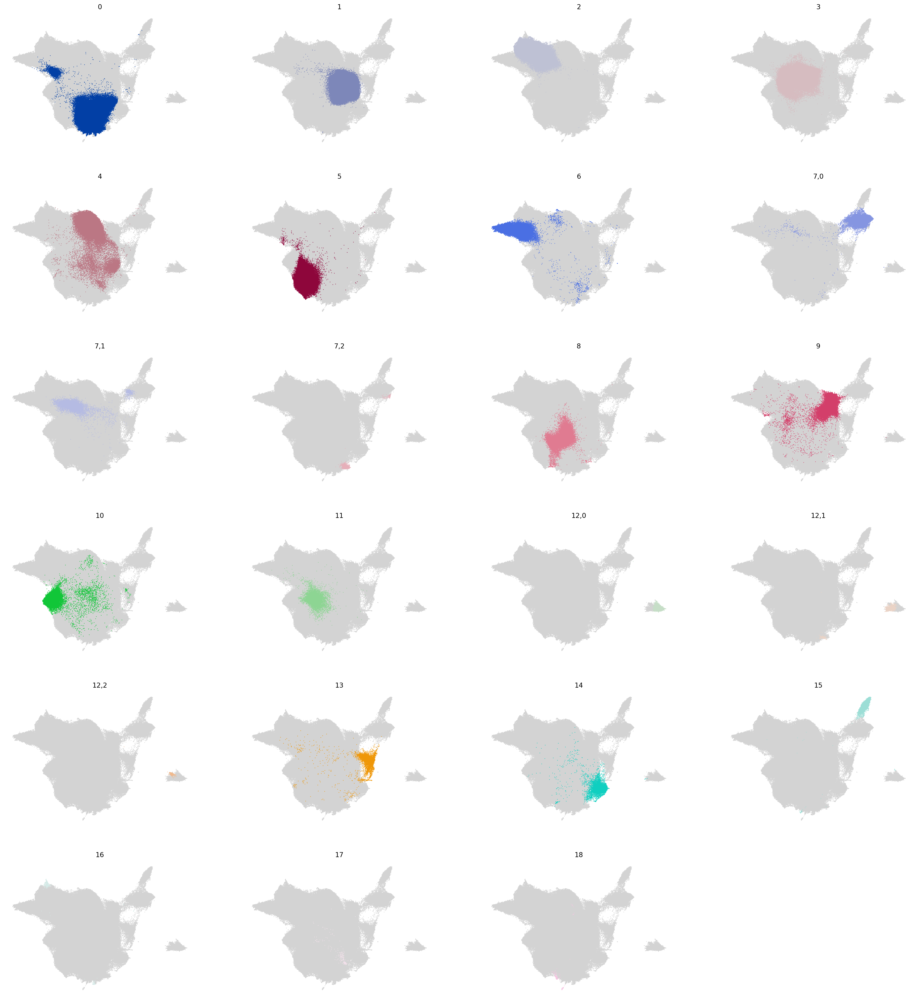

In [43]:
cluster_small_multiples(data, "clean-subcluster-v2")

# Score clusters by gene sets
* Now I have data split into small clusters to help with annotations score all clusters by my various gene sets

In [45]:
#define gene sets
YS_sig = ['PF4','MMP9','E130306D19RIK','CADM1','IRAK1','SH3YL1','DNAJB6','EPCAM','CHR10:117021051-117038683_F','ECD','PFKP','FABP4','MS4A7','DCAKD','GPS1','TRNAU1AP','AGPAT3','DNAJB6','CHR4:145000941-145148666_F','GPS1','SAE1','FOSB','CHR8:91569369-91594119_R','HOXC4','FOLR2','TUBB2A-PS2','GPS1','CHR8:91569369-91594119_R','BAZ1B','OST4','CHR8:72076364-72077503_R','PTPRA','PLOD1','4930555G01RIK','PHF5A','CHR17:95158347-95160942_F','CHR8:48476637-48492537_F','CHR14:44284425-44300475_F','TC1660977','NMD3','PLAU','BTF3L4','CHR17:33995525-34028025_F','CDK2','FCRLS','1110017F19RIK','MAPK9','GDPD1','CHR2:155269145-155303251_F','FBXO30','TRNAU1AP','MRC1','FAM98B','AV575311','CHR17:95158347-95160942_F','CCDC18','ANLN','CTBP2','ACSM3','S1PR1','PXDN','MAN1A','COX6A1','SLC43A3','CCDC47','FAM178A','TNS3','NAP102625-1','PLEKHG5','NDUFS4','CHR10:14888108-14978308_R','UBE2Z','B3GALNT1','TBC1D19','AK007267','MRTO4','TRAIP','CEP55','CHR10:117021051-117038683_R','CHR10:117021051-117038683_R','UTP20','CHR2:108382077-108441137_R','STMN1','4930534B04RIK','CHR14:44146705-44149729_R','CHR10:117021051-117038683_F','STAB1','SMARCAD1','CHR18:78190463-78235438_R','NAP111768-1','CHR5:121768672-121772658_F','CTSB','MAN2B2','PTN','SLC30A7','LHFPL2','CXCL2','RALGDS','CHR4:133368314-133380210_F','CHR8:19682258-19700836_F','A_55_P2169539','CHR7:99879368-99889978_F','ABCB8','NDRG3','PEG3','NUF2','SENP5','SLC35D1','AI462493','RILPL1','CHR2:108382077-108441137_R','NDUFV1','AHSA1']
HSC_sig = ['TTLL3','FAM55D','6330418K02RIK','GDA','GPR35','IFITM6','XDH','8430419L09RIK','PIRA11','CD74','LOC100038947','MBP','S100A8','GM10693','F12','PID1','A_55_P2184200','CCR2','LILRA6','ETOHI1','PNRC1','ARHGEF37','UBP1','TREML4','VMN1R174','POLR1E','ART2A-PS','CYTIP','TEAD1','KLRA2','GZF1','PLAC8','ENSMUST00000103299','RASGRP4','KLF13','PLBD1','CHR2:128249388-128250301_F','PIRA6','MPG','DENND1C','SMPDL3A','DGKG','ENSMUST00000050386','LIME1','HIST1H2BP','1700112J16RIK','OASL2','PTHLH','AHNAK','CHR3:79069438-79073704_R','A_55_P2050722','KYNU','RAC2','TCTEX1D2','SELL','KLRA9','CHR10:66559716-66647841_R']

In [46]:
#define gene sets
CD5nDC2_up_vDC3 = ['MS4A1','IGHM','IGHD','FCRL2','COL19A1','FCRL1','CDH17','DPP4','CLNK','ATP1A2','IGKC','LAD1','IGLC2','SEPT3','CD200','IGLV2-14','GLDN','MZB1','PLEKHG1','CNR2','CXCR3','CYP2E1','ZNF726','RAB30','WFDC21P','ABLIM1','KCNK17','CTB-114C7.4','IL18RAP','SIGLEC6','IDO2','FRMD5','CD207','LAMP3','CD79A','MTCO1P11','HIP1R','IKZF3','RANBP17','EHF','GTF2IRD1','CLEC4C','KIT','IDO1','ZEB1-AS1','RP11-318A15.2','ZEB1','HOPX','PAWR','RIC3','BTLA','FAM129C','BMPR1A','CD19','THNSL1','GIPR','AKAP6','DNASE1L3','GALNTL6','PPP1R14A','FCRL6','PIGR','CARD11','DANT2','RASAL1','LINC00923','ADAMTS2','TRPC6','PTK7','HIST1H2BO','PARD6B','ABO','DUSP4','CTD-2236F14.1','KLF3-AS1','TLR10','DAPK2','RHOH','SPOCK2','NCKAP5','TRIM45','LINC00926','FCMR','CD5','SLCO5A1','SYNE2','SLC22A23','CARMIL2','HLA-DOB','ABCB1','IL18R1','SLC16A14','RP11-63K6.1','SNX25','TPD52','CCR6','E2F1','P2RY10','CLIC3','ELAVL4','CTC-450M9.1','SLAMF7','CD200R1','APOC1','LIN9','TMEM14A','TNFSF15','P2RY14','LILRA4']
DC3_up_vCD5nDC2 = ['MARCO','NHS','WDR86','ATP6V0C','CD163','GIMAP4','ARNTL2','RHOBTB3','RNASE2','C1orf228','SLC7A7','VSIG4','CCDC149','GPRC5A','CLMN','CTC-510F12.4','S100A12','PADI4','RUSC2','AMDHD1','LONRF3','PVT1','COL7A1','NCR3LG1','ABCC3','IER3','MT1E','F13A1','SMPDL3A','LAMP1','HAL','LINC01226','AK4','MMP17','PLCB1','NOL3','RASL10A','RP4-737E23.5','GLT1D1','PTGES','CFD','FCN1','LINC01126','VCAN','GPR161','TMEM255B','STAB1','HK3','VPS37B','RP5-1107A17.4','IFI27','MCEMP1','S100A9','CTD-2017C7.2','SLC22A18AS','CATSPER3','TMOD2','ARAP3','KCNE1','LINC01506','C5AR1','CRISPLD2','CATSPER1','PLA2G7','CRACR2B','LINC00937','LPAR1','KIF3C','ADRB1','MT1F','MAFB','APOBEC3A','FGFR1','PTPN13','S100A8','FOLR2','GPNMB','C9orf106','SLC11A1','FOXP4','SOCS2','CCDC163','BMP2','TMEM176B','CYP27A1','TMEM176A','PLEKHN1','TRIM7','TMTC1','TREML3P','RP11-44F14.1','FOLR3','SLC22A16','DOK3','TNNT1','ACOX2','SERINC2','NRG1','CDA','CLEC4E','XXbac-B562F10.11','FCGR1A','DAGLA','CKAP4','ALOX15B','CLEC4D','RNASE1','ZNF853','UBXN10','HPSE','CD14','CXCL10','F5']
CD5pDC2_up_vDC3 = ['BDKRB2','LAD1','CLNK','NCCRP1','GLDN','CLEC4C','CD5','WFDC21P','ATP1A2','DPP4','LAG3','CXCR3','GTF2IRD1','BCL2L14','SIGLEC6','CARD11','CCL19','PPP1R14A','SLC4A9','COL19A1','LAMP3','DAPK2','RAB30','SEPT3','CYP2E1','BTLA','KCNK17','CDH17','KIT','TRPC6','EHF','LILRA4','CARMIL2','PLEKHG1','TTC26','CD200','RP11-83C7.1','IDO1','DUSP4','GIPR','FCRL6','RP11-1348G14.6','ABLIM1','ZEB1','CNR2','IDO2','SEMA4C','ZEB1-AS1','CD207','IGHD','PLS3','THSD1','RHCE','ZNF726','CTD-2236F14.1','CLIC3','SEPT1','FAM167A','LRTM1','RP11-318A15.2','C1orf115','GALNTL6','CNN3','IL9RP3','HLA-DOB','TLR3','SLCO5A1','CDH1','P2RY10','APOC1','IFNLR1','TOX2','TPX2','NCKAP5','LINC00923','PTK7','RHOXF1-AS1','ZNF114','SH2D3A','DNASE1L3','ADAMTS2','AC023590.1','AKAP6','CYP4F3','CCR7','LINC01819','MSLN','SLC22A23','TMEM121','RASAL1','IL18RAP','FAM57A','NPIPB6','OBSL1','RANBP17','SLC4A3','GPR171','CTD-2319I12.2','LTB','SLC12A3','ABTB2','HOPX','RPS6KL1','P2RY14','FAM46C','TRABD2A','HIC1','SLAMF7','IGHEP2','TLR10','ARHGAP22','AC013474.4','CTC-450M9.1','RP11-890B15.3','RP11-166B2.3','CTLA4','JADE3','QRICH2','SCN9A','IL18R1','CIB2','ANK3','STON2','AC018755.16','TBC1D29','DNAI2','CENPF','ALPK3','BIK','IRF4','SEMA7A','LINC02182','RP11-356J5.12','RP11-112J3.16','AUTS2','TRIM45','MED12L','DUOX1','MTERF2','TNFRSF25','YPEL1','TCEA3','SPOCK2','ILDR2','AXL','RAMP1','STX18-AS1','TRIB2','KIRREL3','RP11-63K6.1','PPM1J','RNA5SP465','ZNF542P','CNFN','WHAMMP3','KIFC1','KLF5','CD200R1','CYFIP2','MCOLN2','ADAM19','TTLL9','BEND5']
DC3_up_vCD5pDC2 = ['PILRA','WDR17','NRGN','OLR1','SIGLEC11','CEBPB','PIK3IP1','CD300E','ASGR1','PTX3','NKG7','IER3','MEI1','MLKL','CAMK2D','STS','DUSP6','RIMKLB','CSF1R','SLC7A7','ABCC3','CD36','TBC1D30','PTGER2','MYC','HNMT','ARHGEF10L','RHOBTB3','ELL2','RFX2','LAMB2','FXYD6','PLCD3','CHST13','CCDC151','MGST1','C5orf58','SNX21','RAB44','NFE2','TGFA','RAB13','TESC','IKBKE','QPCT','LDLR','RIN2','LINC01431','FAM213A','EREG','RP11-107E5.4','RGL1','HP','NHS','TMEM53','C1orf228','F8','FKBP9','GIMAP7','SPR','MITF','TRAIP','ZHX3','SEPT8','FAM92A','TCN2','CACNA2D4','TFEC','CLIP4','CTD-2589M5.5','GPR27','VSIG2','NID1','HK3','CACNB3','AC091814.2','RAB3D','DOC2A','TMC4','TRNP1','ADM','PYGL','MMP17','LINC01226','COPZ2','LONRF3','OSM','PPFIBP1','IFI27','ID1','MT1E','C9orf106','FCER2','BMP2','CFD','LDLRAD3','TMEM106B','RP11-324E6.6','PLPPR2','CDC42EP1','RASL10A','SNTB1','PID1','TMEM255B','SIGLEC15','RP5-1107A17.4','GIMAP1','ST6GALNAC3','RP11-597D13.9','NRP1','SLC22A16','PLPP7','MN1','SLC22A4','SLC22A15','CD9','PTPN13','NLRP12','PTGR1','TNS1','CD209','HACD1','SMAD6','DAGLA','ST3GAL5-AS1','C5AR1','NCR3LG1','MCEMP1','FAR2','RP11-463O12.5','TREM1','OLFML3','PLD1','LAMP1','AIM2','STARD13','LBX2-AS1','CTC-510F12.4','RP4-737E23.5','OPHN1','LPAR1','BST1','DMXL2','SLED1','SOCS2','SDC4','GIMAP4','LINC01140','RP11-351I24.1','AC091814.3','CES1P1','FBN2','CLMN','SDC3','SEMA4F','FOXP4','RBP7','SEPSECS-AS1','MTMR11','NECTIN4','RUSC2','CCL2','APOBEC3A','PRKCDBP','RP11-521C22.2','TMOD2','ASB9','CXCL3','FAM198B','EPDR1','KLHDC8B','C1QA','CCDC136','VSIG4','RP11-84C10.2','VPS37B','ALOX15B','P4HA2','CES1','TDRD9','GPNMB','ADAMTS10','ANKRD22','CRISPLD2','DLGAP1-AS2','PLCB1','HAL','CRIP2','ARAP3','FCN2','TMEM176A','S100A12','DSC2','KCNN4','PVT1','RP11-84G21.1','CD163L1','STAB1','TMTC1','FCGR3A','SIGLEC12','THBS1','CRACR2B','CYP27A1','RP11-344B5.2','RNASE3','PLA2G7','FCGR1A','AK4','FFAR4','GGT5','LINC00937','S100A9','CXCR2P1','CTDSPL','KCNE1','PTPRH','CATSPER1','F13A1','KIF3C','CD163','RP11-44F14.1','PTGER3','ST8SIA6','MLC1','MAFB','ADRB1','DOK3','FCGR1B','CLTCL1','C1QC','NRG1','VCAN','TMEM176B','SERPINB2','OLFM1','F5','HPSE','LINC01506','CMKLR1','CCDC149','FCN1','TREML3P','CD14','TNNT1','CLEC6A','SLC11A1','RP1-122P22.2','RPL7AP64','FAM151B','ACOX2','SHROOM1','CDA','RNASE2','CXCL10','RP11-362F19.1','SERINC2','RP11-305L7.7','CLEC4D','FOLR2','MT1F','RP11-544M22.8','RP1-229K20.5','TMEM150B','SMPDL3A','RNASE1','PTGES','S100A8','EPHB2','LRP3','GIMAP8','CLEC4E','C5AR2','TXNRD3','GLT1D1','FOLR3','CKAP4']
DC3_up_vMono = ['FKTN','MDK','C12orf45','LRRCC1','RHOC','SMYD5','MUC12','FABP5P7','TNFRSF21','SELENBP1','AF131216.6','BORCS5','NRSN2','ZNF585A','ORC6','ZNF630','ADRB1','CD59','CELA2B','ATF7IP2','SCN9A','CAD','NET1','MKL2','PEBP1','CIITA','TSPOAP1','CEP128','REEP6','DNM1','PROC','CCND2','TMEM67','PADI6','ABHD15','SEPT11','LINC01315','TOMM34','ZIK1','MAP3K6','LINC01431','CYP2U1','IQCJ-SCHIP1','EFNB1','ZNF248','MS4A4E','SGCA','TTC27','RP11-514P8.10','DNAJB5','BANK1','PRKAR2B','ZNF582','FOXP1-IT1','CDK18','NKG7','ARL4D','PRKACB','ZBTB46','ALDH18A1','AIG1','LINC00665','ADGRL1','GAMT','RP11-162G10.5','PLEKHA5','MAP7','PCNX2','CCNE1','NIPSNAP3B','SOX12','CHST10','RGS1','ABCC4','RGAG4','FMN1','PON2','PCED1B-AS1','ZEB1','AF064858.11','HLA-DPB1','MPP3','PDE2A','ATP5F1P1','CEP41','STMN1','IQGAP3','HAPLN3','ZNF790-AS1','ACSF2','RP11-465B22.3','ZNF469','CMTM8','SUV39H2','HIST1H2AG','DENND5B','GFRA2','MYO5C','IL21R','DST','SEPT7P9','SRGAP3','SLC25A15','KLRG1','GHRL','RP11-53B2.4','HLTF','CD72','LDLRAD4-AS1','RP11-464F9.20','RPL21P5','CABLES1','CLEC17A','TTC8','ZNF138','RP11-635N19.1','SEMA7A','TNFRSF25','COL9A2','MICAL3','MCM2','GPRIN3','PPP1R16A','TCEAL1','WNT2B','TXNRD3','TCTN3','TRPC2','TSPAN33','SORBS3','RP11-705C15.3','KLHL3','ROBO1','FABP5','CHCHD6','SEL1L3','VSIG4','PTGFRN','CTB-50L17.16','RP11-28G8.1','RP11-75C10.6','FADS2','TNNT3','BMP2','GPA33','TSPYL5','UHRF1','EXPH5','GUCY1B3','EPB41L2','EMP1','RP11-231E4.5','PTTG1','CD226','TRAF5','BMS1P1','FGF9','CCL28','DFNA5','FKBP7','BICC1','ADAT2','GOLGA8A','ANKH','UPK3A','TLR10','PCED1B','OSGEPL1','GSTM2','HLA-DQB2','SPATS2L','EMILIN1','SACS','MAGEF1','RPS6KA2','SCML2','MTHFD1L','RP11-277P12.20','ITGB5','RAB39B','AP1S3','ACOT2','LY9','BATF3','CCL22','SMOX','USP13','ADGRG5','RP11-351C21.2','RP11-426C22.4','E2F5','ESR1','FAM69A','ADGRE4P','NRARP','TMEM97','KLF12','CTD-2373N4.5','TWNK','KLRF1','ASB2','TVP23A','C5orf63','SLAMF8','OCIAD2','GRAMD1C','ALDH7A1','BACH2','NEGR1','ST3GAL4-AS1','RP6-91H8.3','MBNL1-AS1','LGMN','BIN1','TRIB2','CD5','ZNF10','PHGDH','KDELC2','RP11-12G12.7','SEZ6L','PPM1J','CTTNBP2NL','PLEK2','CD109','ZNF256','METTL7B','HLA-DQA2','CD180','RAVER2','ATP10A','ZNF543','GATM','SLFNL1','CD69','KLF8','HLA-DQA1','MAP4K1','ASB9','GOLGA8B','HBB','KIF18A','TMEM237','PIK3C2B','MN1','CST7','FPR3','PRKCDBP','CDR2L','DNASE1L3','GNAI1','GFI1','LINC00299','CYP2S1','RYR1','SLC41A2','BMP6','RHOBTB1','DZIP1L','FCRLB','TMEM156','AREG','SLC30A4','TRABD2A','DOC2A','ZNF823','CLECL1','PXDC1','ITGB7','MOCOS','RP11-446N19.1','SLC35F3','RP3-460G2.2','DLGAP1-AS3','BCL2','SCN1B','FAM160A1','ITPRIPL1','RP3-522P13.3','NMB','SPIB','ACOT11','MORC4','FSCN1','BCAR3','BLNK','FAM161A','RP3-522P13.2','DHRS3','FCGR2B','RP11-834C11.4','LIMA1','A2M','CTD-2553L13.9','LRP1B','NAPSB','CTSV','TOP2A','PDLIM1','MYEF2','CCDC113','GEM','BIVM','RP11-542H15.1','PLEKHA6','ZNF154','IDO2','PEBP1P2','IFI27','SLC9A7','ZSCAN18','THEM4','CTB-102L5.7','ZNF366','SDS','HACD1','FAM81A','C1QA','RP11-338C15.3','C10orf128','GAS6','HOMER2','NDN','FAM46C','SNX7','ZFP30','SRGAP3-AS3','DUSP4','ZNF571','HELLS','ME3','PTPN13','NCALD','SPNS3','SEMA4F','AHNAK2','SLC2A1','TUSC1','LAMP5','HOXB-AS1','RP11-191A15.2','RP3-467N11.1','P2RY14','DOCK1','SERPINF1','IRF4','RP4-758J18.13','ADAM28','ACOT7','TENM4','CCDC136','IL1R2','DTNA','ROBO3','P2RY6','NAV1','ZNF571-AS1','GUCY1A3','SLAMF9','TPD52','PARP15','RUNDC3A','HOXA9','TMEM14A','CDS1','LINC01537','HSPG2','SH3BP4','RP11-863P13.4','SOCS2','CTD-2195B23.3','TMEM204','CSNK1G2P1','ZNF17','LHFP','ZNF660','ACVRL1','DNAI2','TMEM231','PLXNA1','BEND5','ZNF826P','PGAM1P7','UNC13B','CEP126','LINC01140','ZNF470','MAMSTR','HLA-DOA','RP11-413E1.4','GPR146','S100B','ADORA1','LMCD1','ALOX15','ID3','FLT3','TSPAN15','ZNF347','ZNF599','BAG2','C11orf63','AUTS2','CRIP3','RP11-356M20.1','TYRO3','CTSW','SCHIP1','STKLD1','CCDC26','ST8SIA6','AK5','H2AFY2','LINC01684','LMNA','PLD4','TESPA1','CEP112','RNASE1','CLIC2','PPP1R14A','ABCB4','KIF17','ST18','PTGDR2','FCGBP','RP11-219B4.3','ITM2C','SEPT8','MYBPC2','MAP1A','ADAMTS10','RP13-580F15.2','SCGB3A1','ALG1L2','RP5-888M10.2','RP11-345J18.2','CCNB2','AKAP2','ZNF711','GRIP1','RP5-1063M23.3','DCLK2','CA11','AFF3','MSLN','FAM86EP','CTC-265F19.1','LINC02182','DHCR24','CTD-3116E22.8','CLEC10A','TSGA10IP','PHYHD1','CD1C','NCKAP5','CD1B','RNA5SP371','IL18R1','ADGRG6','C1QB','IGFBP6','BEND6','CPXM1','RP11-863P13.5','DPPA4','HHLA2','DEPTOR','ROBO4','POM121L14P','GRAMD3','P3H2','CCSER1','HBA2','TNFRSF11A','CDC20','CD6','KRT18','AXL','ACY3','RAMP1','GALNT12','PKIB','LTK','CLEC4F','FIRRE','RP11-365O16.3','C12orf75','HTR7','BCL7A','RP11-144G6.12','TCEA3','SLC4A3','NDRG2','MATK','PARM1','HLA-DPB2','LPAR5','RP11-863P13.3','RP11-404O13.5','MCOLN2','CD2','GIPR','UST','MRC1','CD207','SLC38A1','PALD1','EPHB3','FBLN2','CD1E','ENHO','LAYN','FCER1A','SLC35F2','NFATC2']
Mono_up_vDC3 = ['RP11-925D8.3','MTND5P32','CYP1B1','S100P','WLS','MCTP2','FCAR','TMEM38A','LIN7A','RP11-240E2.2','ALDH1A1','VNN3','C9orf47','DYSF','RBP7','BPI','F3','RP3-525N10.2','OLIG1','MTCO3P23','C5AR1','TSHZ3','ADGRG3','DES','SERPINB10','PROK2','STEAP4','MTND3P12','S1PR3','MARC1','RP1-55C23.7','ARHGAP29','SUMO1P1','TFCP2L1','STK32B','NLRP9P1','ME1','VSTM1','MYO7A','APCDD1','CDA','RPL34P22','FPR2','NPL','VNN2','GGT8P','GPR27','KCNJ15','GLT1D1','RGMA','RXFP2','CTD-2530H12.2','RPH3A','ECE1','RP11-34P13.16','COCH','ZBTB16','KIAA1257','RP11-295K3.1','PGA5','KRT23','AQP9','F5','CXCL8','CXCL1','RP1-229K20.9','DOCK6','CPAMD8','BEND7','LINC00671','LILRB5','ADGRB3','G0S2','APOBEC3A','ELANE','RP11-81A1.7','LPL','MGAM','CYTL1','THBS1','PRLR','ZFP92','ABCA13','CRISPLD2','RP11-47L3.1','RN7SKP190','SOWAHC','KREMEN1','SMPDL3A','ADAMTS5','CMTM2','TPRG1','NEK8','CLEC4D','BEX1','RP5-1071N3.1','ROPN1L','RP11-34P13.15','SHROOM1','PNOC','HOMER3','CTD-2033D15.2','RP11-58K22.4','CYP27A1','TNFAIP6','AC138035.2','WNT11','RP11-362F19.1','RP11-651L5.2','CD14','RP5-892K4.1','DLEU7','SPRY1','GOLM1','CYP1B1-AS1','FCGR3A','CR1','FRMD3','RP11-12A2.1','FOLR3','CDKN2B','CTB-114C7.4','AC068580.6','SLC41A1','BCL2A1','AC005301.9','CTC-490G23.2','AC011380.8','RP11-1228E12.1','DGAT2','P3H3','TDRD9','CETP','RP11-678G14.3','RP11-362F19.2','PLPP3','TMEM150B','PADI4','RP11-280G9.1','C3AR1','ALDH1A2','ADM','LINC01127','C3','S100A12','PNPLA1','Z97634.3','RP11-10J5.1','NOTCH4','HP','AATK','MCEMP1','AC068580.5','C5AR2','RP11-367G18.1','RP11-483P21.2','RP11-254F19.2','SLC11A1','RP11-370I10.2','ALG1L13P','APOBEC3B','FPR1','RP4-714D9.5','CSF1','NIPAL4','LLNLR-271C9.1','FAM157B','LINC00656','LIPN','LRP3','SLC24A4','DNAAF1','CLEC5A','ADORA2A-AS1','RNF152','DAPK2','KANK2','EHD4-AS1','STAR','OR7E140P','FBXL16','CATIP','CD82','SEPT10','AC074289.1','CDC42EP2','DLC1','RP11-358B23.7','ANPEP','HTRA1','VNN1','TRPV4','TOX2','ST6GALNAC2','CHST15','RP11-290F24.6','DOK3','RP11-59D5__B.2','PPARG','CLEC4E','RP11-313P22.1','RP4-673D20.3','TMEM176A','LRRC75A','NCF1','FBN2','RP11-728F11.4','TMEM176B','LINC01002','SERPINB2','TREML4','GLIS3','ZG16B','NCF1B','DSC2','TRIM7','ADAMTS2','EPHB2','TPRG1-AS1','S100A8','ACSS3','RP11-34P13.13','RP11-153M7.3','DBN1','RN7SL749P','GK-IT1','NCF1C','ETV7','SLC47A1','TNIK','RP11-549L6.2','HAL','LRRC4','C1orf115','MIR7848','SERINC2','OPLAH','MAFB','FXYD6','MERTK','IGF2R','AF124730.4','LINC01001','LPAR1','AMPH','OR52K3P','COLEC12','LUCAT1','RP11-1334A24.6','ARHGAP24','CDC42EP3','FFAR2','CYP4F3','EHD1','LINC00937','PPP1R27','IER3','TPTEP1','GLULP4','FAM157C','HPSE','ABCC6','LINC01890','DLEU7-AS1','ELOVL3','SLCO4C1','SLC44A2','HK3','CXCL2','RP11-890B15.3','RN7SL368P','DPEP3','TPST1','PSD','S100A9','MRVI1','FAM110B','RP4-737E23.5','ABHD12B','SH3RF3','CCR1','RP11-798K3.2','SLC22A15','LOXL1','F12','AK3P5','CECR6','SLED1','CTSD','RP11-350G8.5','Y_RNA.6','LINC01948','LDHD','SMIM25','RP11-74K11.2','TNFRSF8','RP4-576H24.2','CKAP4','CXCR2','SLC2A14','ZNF185','SUMO2P8','LIN9','NOCT','ZNF697','RUBCNL','GLUL','SASH1','EIF4E3','RP11-217B7.2','OPTN','SOCS3','RP1-229K20.5','LMTK2','GRB10','KLHDC8B','RP11-44F14.1','SLC2A3','RP11-701P16.2','ACSL1','IL31RA','EXOC3L1','ADARB1','ACSM3','CD68','MME','LHFPL2','RP11-443B7.3','LRG1','LIMK2','AC005082.12','RHOU','CD93','FAM198B','UPB1','IRS2','ITGA1','MAP3K7CL','SIRPD','RFLNB','RP11-452H21.4','ASF1B','HGF','CFD','SLA','CERS4','CATIP-AS2','DMXL2','TLR4','PFKFB4','ADAM19','CTD-2516F10.2','CASP5','RP11-156K23.3','AC017002.1','PTP4A3','MIR3945','RUSC2','CLTCL1','EIF4EP1','PLIN2','NATD1','EPN2','PLAUR','LINC01506','TSPAN2','LINC01094','LINC00482','KCNH3','CD300E','PECR','DNAH17','AC009303.2','BST1','RAB37','ARRDC4','ATOH8','SNED1','SNX18','IGF2BP3','C9orf106','RP11-351I24.1','KLF5','PRICKLE1','AP5B1','SDCBPP3','PSRC1','ADGRE3','TNF','PTGES','NINJ1','LINC00921','LINC01888','SPOCK1','RP11-482G13.1','MXI1','NAMPT','PELI1','TNFRSF10C','DCHS1','CTSL','PLEKHG3','ELL2','RGL4','HIST2H2BF','ZNF219','SOD2','SCN4B','MMP25','CMKLR1','TUBA4A','CTDSPL','CLU','GLB1L','SNX21','RP11-45M22.5','TMEM91','CLIP4','PFKFB3','NECTIN1','RHD','FCGR1CP','CTSS','ZNF438']


In [47]:
#make an object with my sigs - see excel file Nikita-mregDC_DEG_summary on i drive
My_Uptake_sig = ["CCL22","IL4I1","SIRPA","CCR7","CHST11","GPR157","RGS1","BIRC3","TRAF1","CSF2RA","TBC1D13","LAMP3","MREG","PPP1R14A","SPRED2","CD83","TXN","MOB3A","NFKB1","TBC1D4","CDK2","WFDC21P","ARAP2","ZER1","ACSL1","SPINT2","SQSTM1","TBC1D8","JAG1","AC073508.3","BATF","ETV3","BCL2","KIF2A","FSCN1","TNFAIP3","CCDC28B","NR4A3","CYTIP","PLEK","FOXO1","TOMM34","TRAFD1","PPP1R16B","CXCR4","CD40","ENTPD7","CDKN1A","BID","MARCKS","DUSP5","MAP4K4","BCL2L1","ISG20","RNF145","RNF121","GPR132","RASGEF1B","CYRIA","RAB10","CERS6","IL1R1","STK4","CLEC2D","AL390719.1","ZBTB38","IFNGR2","CD274","SLC41A2","NRP2","ANKRD33B","GPR183","POGLUT1","ADORA2A","JADE3","KHDRBS3","CTNNB1","SLCO5A1","NFKB2","RGS2","SEC61B","ZNRF1","RELB","C12orf45","IRF2","EPOP","MXD1","RAB5B","PADI2","DRAM1","MTMR4","EEF2K","GCNT2","RAPH1","BCL2A1","SEC23B","PIM3","ANTXR2","ABTB2","TMEM200A"]    

In [48]:
mregDC_sig = ['CD40','CD80','CD86','RELB','CD83','CD274','PDCD1LG2','CD200','FAS','ALDH1A2','SOCS1','SOCS2','CCR7','MYO1G','CXCL16','ADAM8','ICAM1','FSCN1','MARCKS','MARCKSL1','IL4RA','IL4I1','CCL17','CCL22','TNFRSF4','STAT6','BCL2L1']

In [ ]:
DC1_sig = []

In [ ]:
#score genes
sc.tl.score_genes(data, YS_sig, score_name='YS_score')

       'CHR4:145000941-145148666_F', 'CHR8:91569369-91594119_R', 'TUBB2A-PS2',
       'CHR8:72076364-72077503_R', '4930555G01RIK',
       'CHR17:95158347-95160942_F', 'CHR8:48476637-48492537_F',
       'CHR14:44284425-44300475_F', 'TC1660977', 'CHR17:33995525-34028025_F',
       'FCRLS', '1110017F19RIK', 'CHR2:155269145-155303251_F', 'AV575311',
       'MAN1A', 'FAM178A', 'NAP102625-1', 'CHR10:14888108-14978308_R',
       'AK007267', 'CHR10:117021051-117038683_R', 'CHR2:108382077-108441137_R',
       '4930534B04RIK', 'CHR14:44146705-44149729_R',
       'CHR18:78190463-78235438_R', 'NAP111768-1',
       'CHR5:121768672-121772658_F', 'CHR4:133368314-133380210_F',
       'CHR8:19682258-19700836_F', 'A_55_P2169539', 'CHR7:99879368-99889978_F',
       'PEG3', 'AI462493'],
      dtype='object')


In [ ]:
sc.tl.score_genes(data, HSC_sig,score_name='HSC_score')

       'LOC100038947', 'GM10693', 'A_55_P2184200', 'ETOHI1', 'TREML4',
       'VMN1R174', 'ART2A-PS', 'KLRA2', 'ENSMUST00000103299',
       'CHR2:128249388-128250301_F', 'PIRA6', 'ENSMUST00000050386',
       'HIST1H2BP', '1700112J16RIK', 'OASL2', 'CHR3:79069438-79073704_R',
       'A_55_P2050722', 'KLRA9', 'CHR10:66559716-66647841_R'],
      dtype='object')


In [ ]:
colour_vars = ["YS_score","HSC_score","clean_labels_v1"]

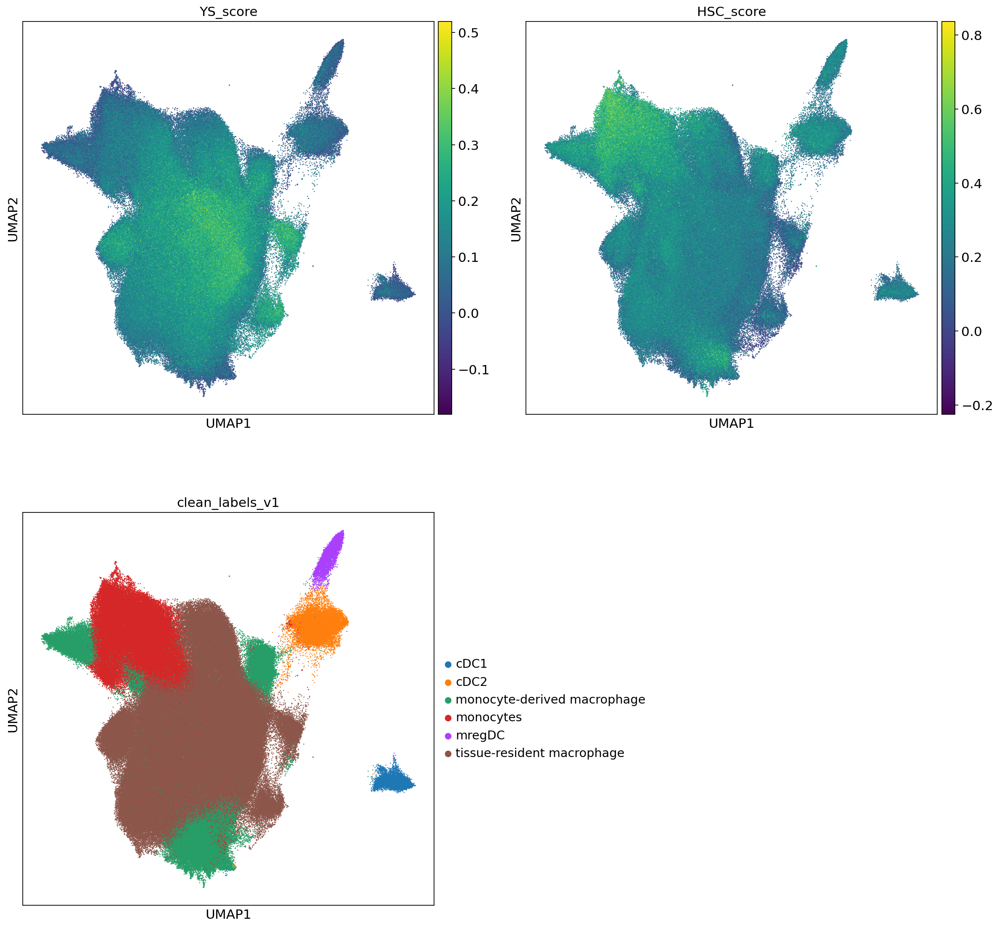

In [ ]:
#plotting 
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color=colour_vars, ncols=2, size=5)

In [ ]:
import numpy as np
import seaborn as sns

In [ ]:
# Calculate the mean scores for each cluster
cluster_labels = data.obs['clean_labels_v1']
ys_scores = data.obs['YS_score']
hsc_scores = data.obs['HSC_score']

In [ ]:
# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'YS_score': ys_scores.groupby(cluster_labels).mean(),
    'HSC_score': hsc_scores.groupby(cluster_labels).mean()
})

/scratch/temp/11099731/ipykernel_184567/3034877435.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/scratch/temp/11099731/ipykernel_184567/3034877435.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


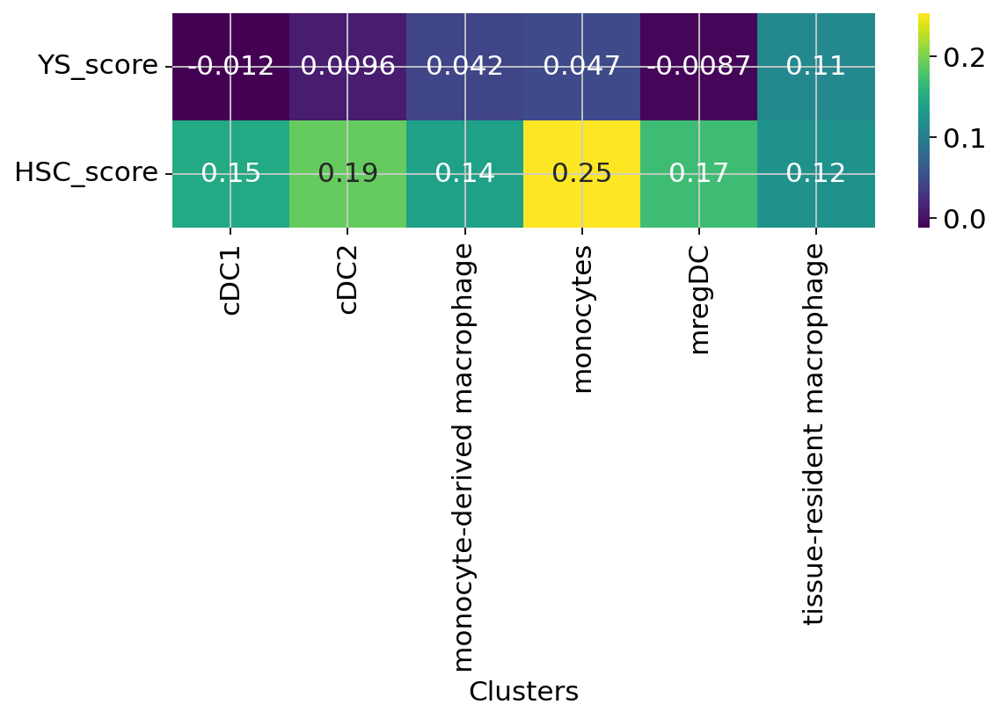

In [ ]:
# Plot the heatmap
plt.figure(figsize=(8, 2))
sns.heatmap(scores_df.T, cmap='viridis', annot=True, cbar=True)
plt.xlabel('Clusters')
plt.show()

In [ ]:
# Calculate the mean scores for each cluster
cluster_labels = data.obs['clean-leiden_subcluster2']
ys_scores = data.obs['YS_score']
hsc_scores = data.obs['HSC_score']

In [ ]:
# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'YS_score': ys_scores.groupby(cluster_labels).mean(),
    'HSC_score': hsc_scores.groupby(cluster_labels).mean()
})

/scratch/temp/11099731/ipykernel_184567/3034877435.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/scratch/temp/11099731/ipykernel_184567/3034877435.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


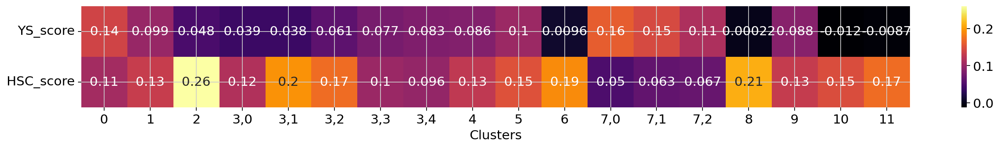

In [ ]:
# Plot the heatmap
plt.figure(figsize=(20, 2))
sns.heatmap(scores_df.T, cmap='inferno', annot=True)
plt.xlabel('Clusters')
plt.show()

### Overlay my tumour uptake signature: 

In [ ]:
#make an object with my sigs - see excel file Nikita-mregDC_DEG_summary on i drive
Uptake_sig = ["CCL22","IL4I1","SIRPA","CCR7","CHST11","GPR157","RGS1","BIRC3","TRAF1","CSF2RA","TBC1D13","LAMP3","MREG","PPP1R14A","SPRED2","CD83","TXN","MOB3A","NFKB1","TBC1D4","CDK2","WFDC21P","ARAP2","ZER1","ACSL1","SPINT2","SQSTM1","TBC1D8","JAG1","AC073508.3","BATF","ETV3","BCL2","KIF2A","FSCN1","TNFAIP3","CCDC28B","NR4A3","CYTIP","PLEK","FOXO1","TOMM34","TRAFD1","PPP1R16B","CXCR4","CD40","ENTPD7","CDKN1A","BID","MARCKS","DUSP5","MAP4K4","BCL2L1","ISG20","RNF145","RNF121","GPR132","RASGEF1B","CYRIA","RAB10","CERS6","IL1R1","STK4","CLEC2D","AL390719.1","ZBTB38","IFNGR2","CD274","SLC41A2","NRP2","ANKRD33B","GPR183","POGLUT1","ADORA2A","JADE3","KHDRBS3","CTNNB1","SLCO5A1","NFKB2","RGS2","SEC61B","ZNRF1","RELB","C12orf45","IRF2","EPOP","MXD1","RAB5B","PADI2","DRAM1","MTMR4","EEF2K","GCNT2","RAPH1","BCL2A1","SEC23B","PIM3","ANTXR2","ABTB2","TMEM200A"]    

In [ ]:
#score genes
sc.tl.score_genes(data, Uptake_sig, score_name='Uptake_score')

In [ ]:
colour_vars = ["Uptake_score","clean_labels_v1"]

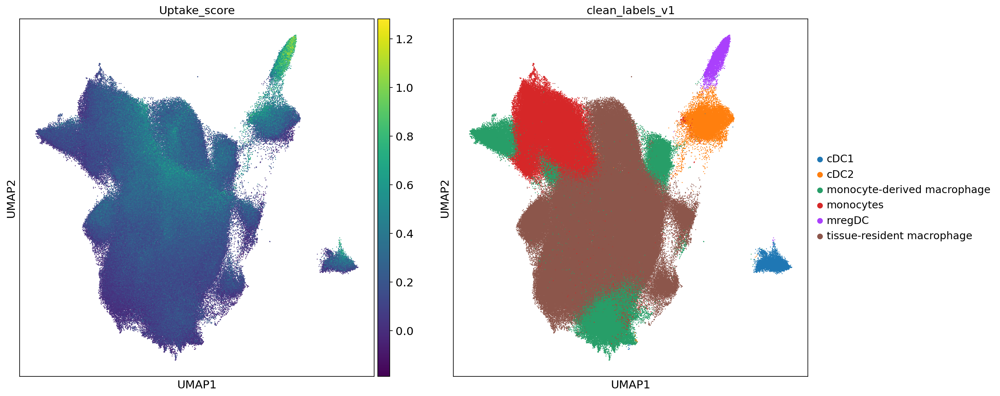

In [ ]:
#plotting 
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color=colour_vars, ncols=2, size=5)

In [ ]:
colour_vars = ["Uptake_score","clean-leiden_subcluster2"]

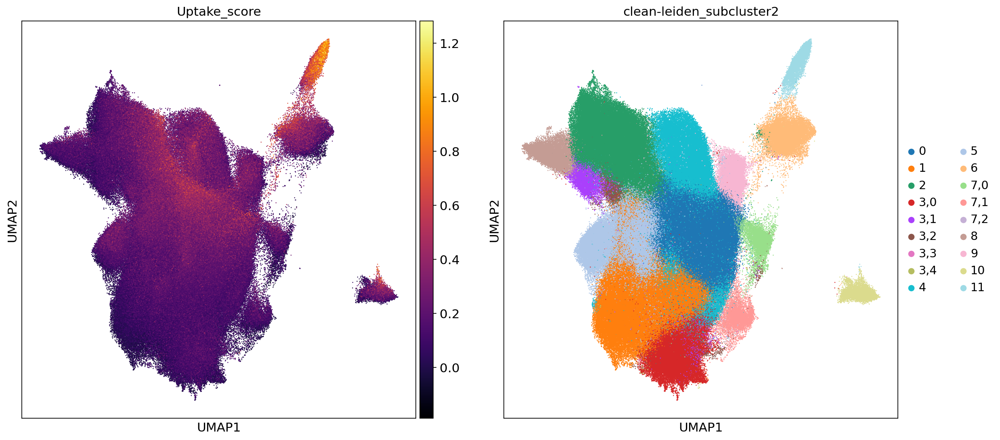

In [ ]:
#plotting 
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color=colour_vars, ncols=2, size=5, color_map="inferno")

In [ ]:
import numpy as np
import seaborn as sns

In [ ]:
# Calculate the mean scores for each cluster
cluster_labels = data.obs['clean_labels_v1']
uptake_scores = data.obs['Uptake_score']

In [ ]:
# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'Uptake_score': uptake_scores.groupby(cluster_labels).mean(),
})

/scratch/temp/11099731/ipykernel_184567/2087912047.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


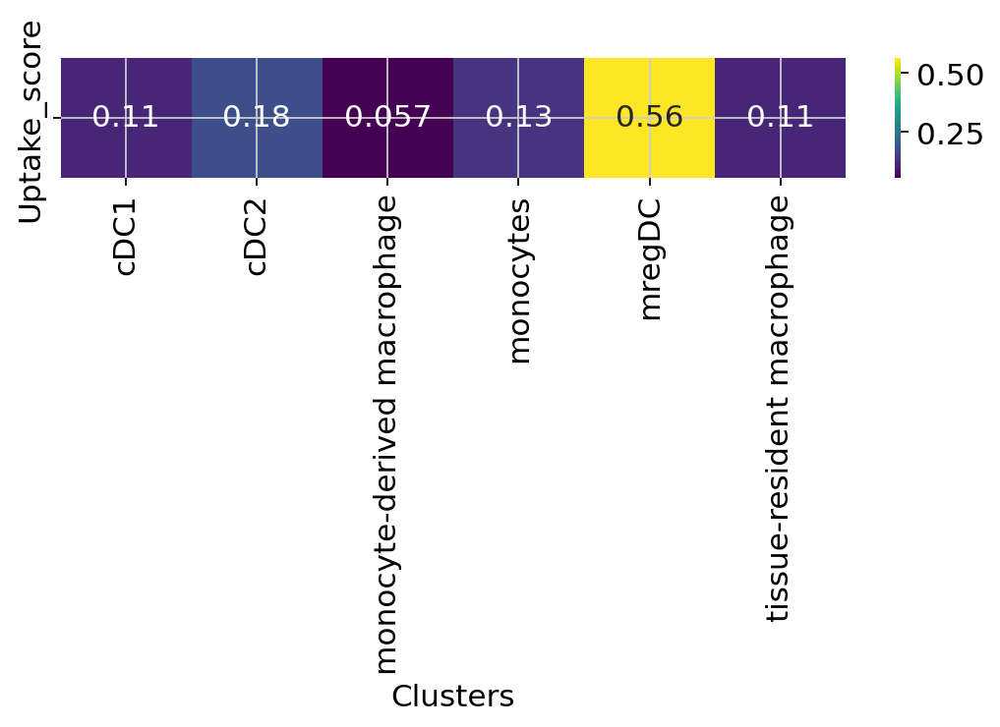

In [ ]:
# Plot the heatmap
plt.figure(figsize=(8, 1))
sns.heatmap(scores_df.T, cmap='viridis', annot=True, cbar=True)
plt.xlabel('Clusters')
plt.show()

In [ ]:
# Calculate the mean scores for each cluster
cluster_labels = data.obs['clean-leiden_subcluster2']
uptake_scores = data.obs['Uptake_score']

In [ ]:
# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'Uptake_score': uptake_scores.groupby(cluster_labels).mean(),
})

/scratch/temp/11099731/ipykernel_184567/2087912047.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


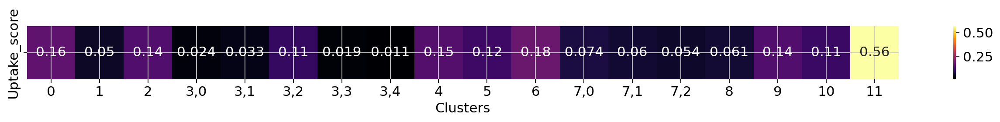

In [ ]:
# Plot the heatmap
plt.figure(figsize=(20, 1))
sns.heatmap(scores_df.T, cmap='inferno', annot=True, cbar=True)
plt.xlabel('Clusters')
plt.show()

### split by cancer subtype

In [ ]:
# Calculate the mean scores for each cluster
cluster_labels = data.obs['clean_labels_v1']
uptake_scores = data.obs['Uptake_score']
cancer_subtype = data.obs['cancer_subtype']

In [ ]:
# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'Uptake_score': uptake_scores,
    'cluster': cluster_labels,
    'cancer_subtype': cancer_subtype
})

mean_scores_df = scores_df.groupby(['cancer_subtype', 'cluster']).mean().unstack()
mean_scores_df = mean_scores_df.T

/scratch/temp/11099731/ipykernel_184567/50111509.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


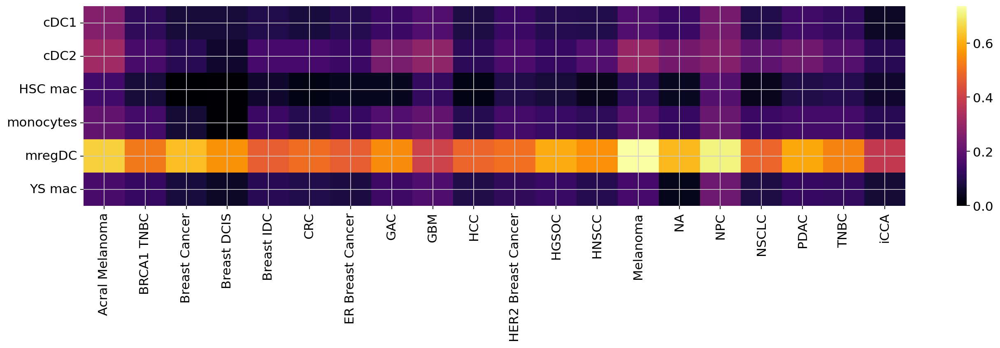

In [ ]:
# Plot the heatmap
plt.figure(figsize=(20, 4))
ax = sns.heatmap(mean_scores_df, cmap='inferno')
ax.set_yticklabels(['cDC1', 'cDC2', 'HSC mac','monocytes','mregDC','YS mac'], rotation=0)  # Change the labels and their rotation
plt.xlabel('')
plt.ylabel('')
plt.show()


# Here downwards from original notebook:

### From this I want to subcluster clusters 3, 4, and 7 as they look like they should be split in 2
* I tried cluster 4 but didn't divide up well, so kept together 
* cluster 7 split in 3 (below)
* cluster 3 split in 5 (below) but some are very small

In [36]:
#subcluster clusters
sc.tl.leiden(data, restrict_to=('leiden', ['7']), resolution=0.1, key_added="clean-leiden_subcluster")

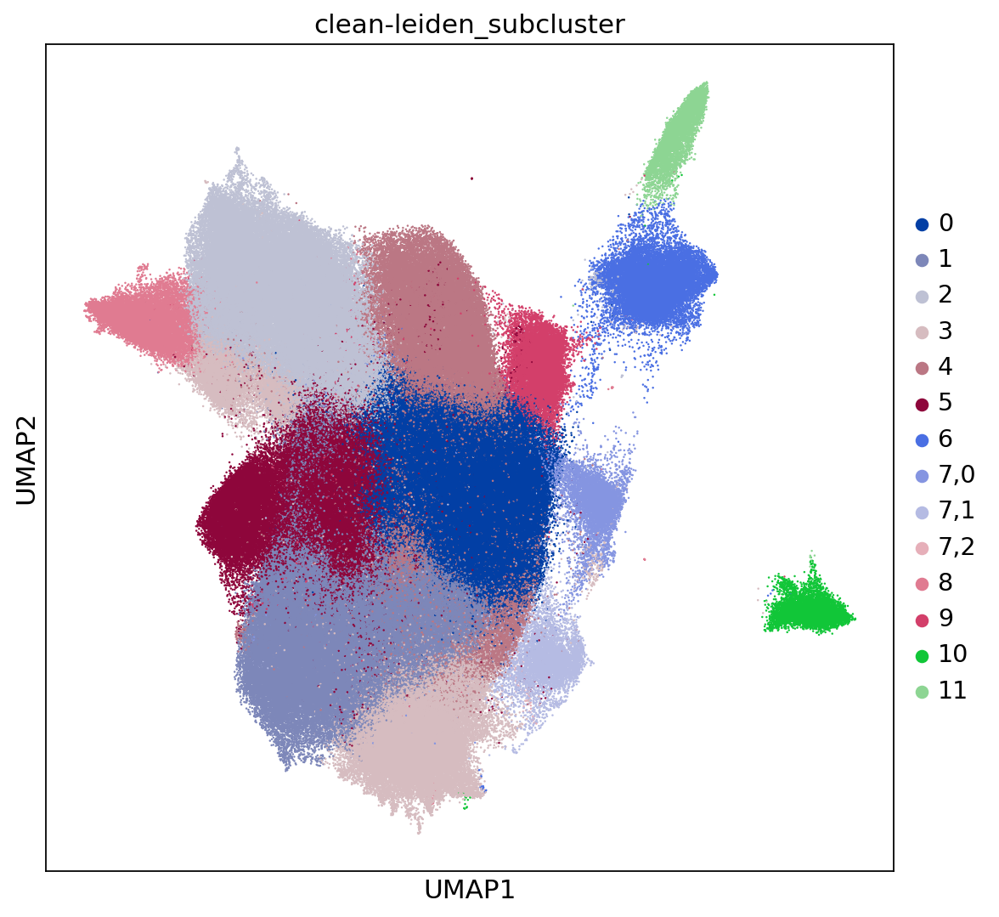

In [13]:
#plotting clusters
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color="clean-leiden_subcluster", size=5)

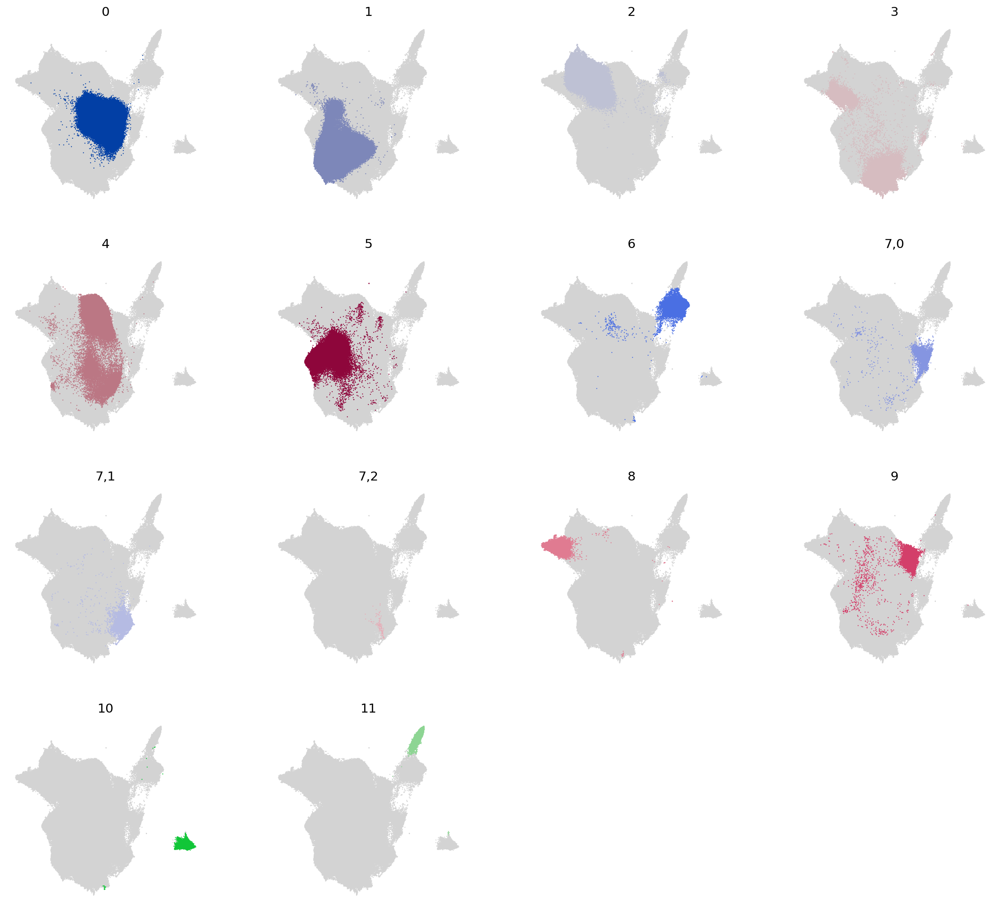

In [38]:
cluster_small_multiples(data, "clean-leiden_subcluster")

In [29]:
#subcluster cluster 3
sc.tl.leiden(data, restrict_to=('clean-leiden_subcluster', ['3']), resolution=0.2, key_added="clean-leiden_subcluster2")

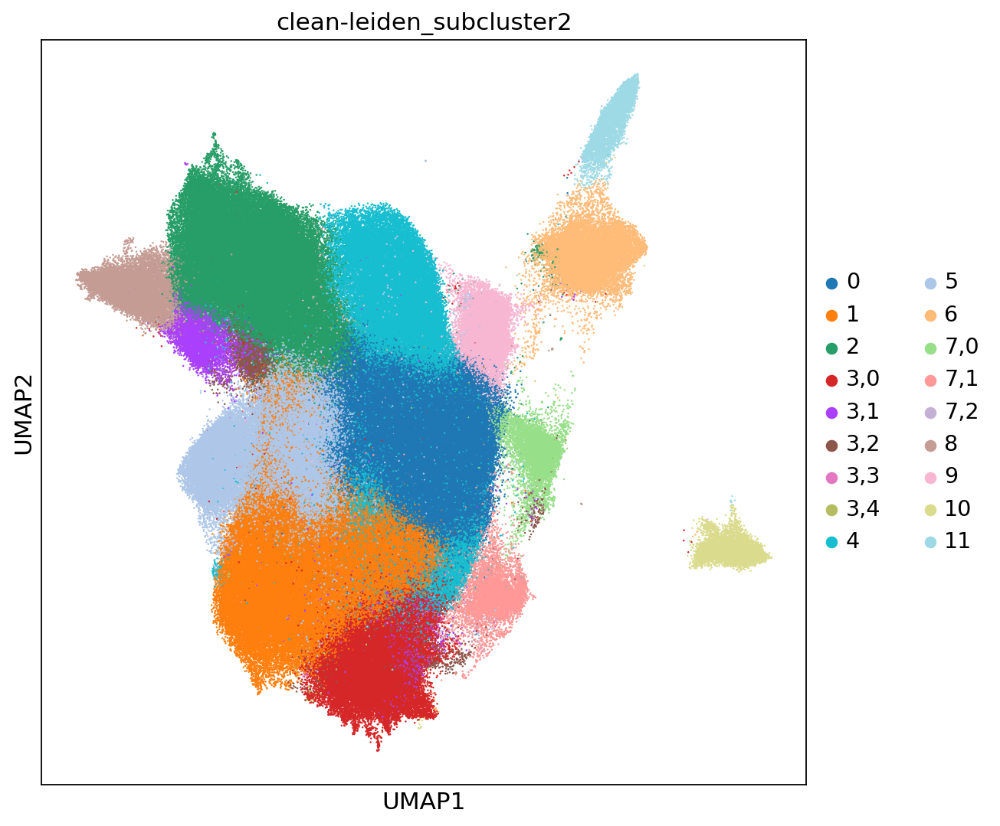

In [30]:
#plotting clusters
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color="clean-leiden_subcluster2", size=5)

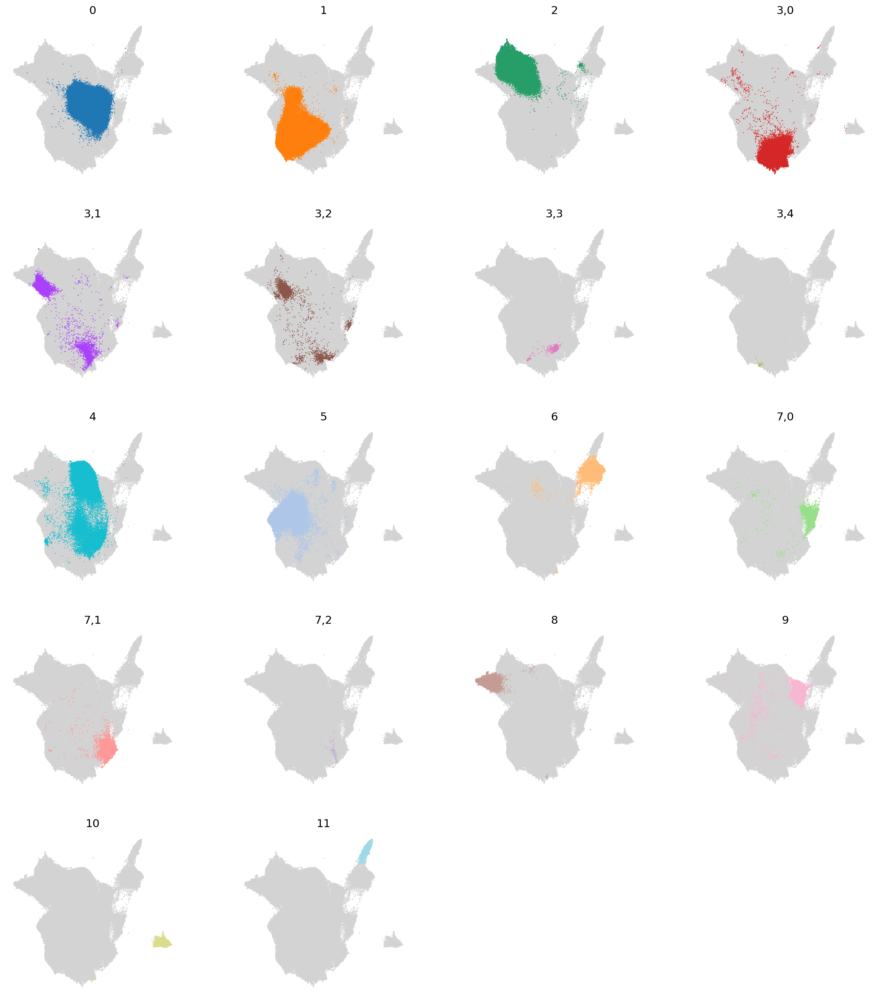

In [33]:
cluster_small_multiples(data, "clean-leiden_subcluster2")

In [34]:
myeloid_genes = {
    "DC": ["HLA-DRA"],
    "cDC1": ["CLEC9A", "XCR1","BATF3","IRF8","FLT1"],
    "cDC2": ["CD1C", "FCER1A", "CLEC10A","CD5","IRF4"],
    "DC3": ["CD1C","FCER1A","CD14","CD163","CSF2RA","CSF2RB"],
    "mregDC": ["LAMP3","CD274","CCR7"],
    "Monocytes": ["CD14", "FCGR3A","CD163","LYZ","S100A8","S100A9","CCR2"],
    "Macrophages": ["FCGR1A", "CD68","CSF1R","TREM2","SPP1","CX3CR1","AIF1"],
    "Tissue Res Macs": ["C1QA","C1QB","C1QC","BTK","C3AR1","CCR1","MERTK"],
    "Proliferating": ["MKI67"]
}

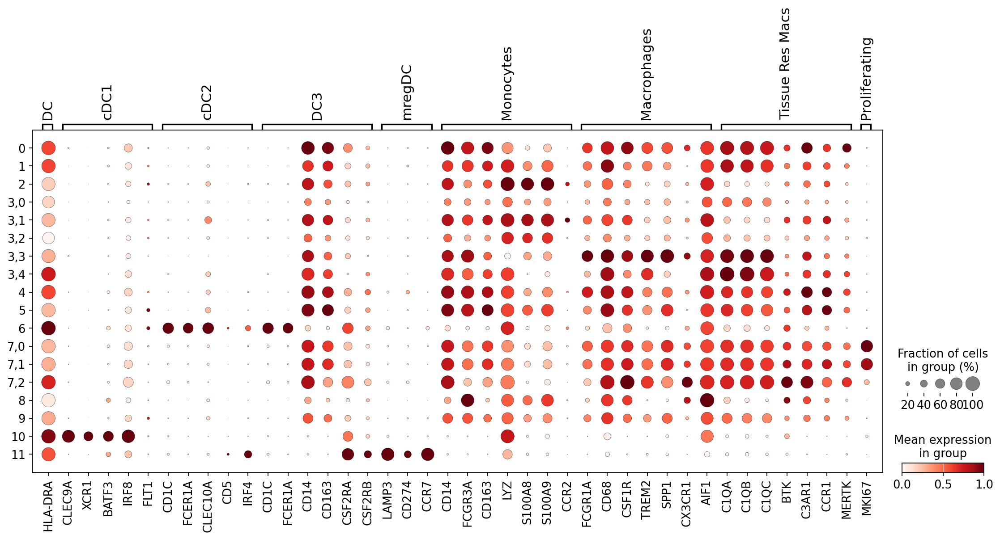

In [35]:
sc.pl.dotplot(data, myeloid_genes, groupby="clean-leiden_subcluster2", standard_scale="var")

### Find DEG genes for each cluster (10min):

In [36]:
#find DEG genes for each cluster: scanpy tute
# Obtain cluster-specific differentially expressed genes
sc.tl.rank_genes_groups(data, groupby="clean-leiden_subcluster2", method="wilcoxon")

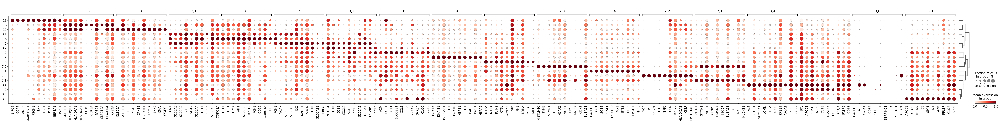

In [37]:
#visualise the top 10 DEG genes for each cluster
sc.pl.rank_genes_groups_dotplot(
    data, groupby="clean-leiden_subcluster2", standard_scale="var", n_genes=10, min_logfoldchange=1
)

### Generate UMAPs with broad marker genes:

In [38]:
broad_markers = ["HLA-DRA", "CLEC9A", "XCR1","BATF3","IRF8","FLT1", "CD1C", "FCER1A", "CLEC10A","CD5","IRF4", "CD14","CD163","CSF2RA","CSF2RB", "LAMP3","CD274","CCR7", "IRF7", "FCGR3A", "LYZ","S100A8","S100A9",
                 "CCR2", "FCGR1A", "CD68","CSF1R","TREM2","SPP1","CX3CR1","AIF1","C1QA","C1QB","C1QC","BTK","C3AR1","CCR1","MERTK","MKI67"]

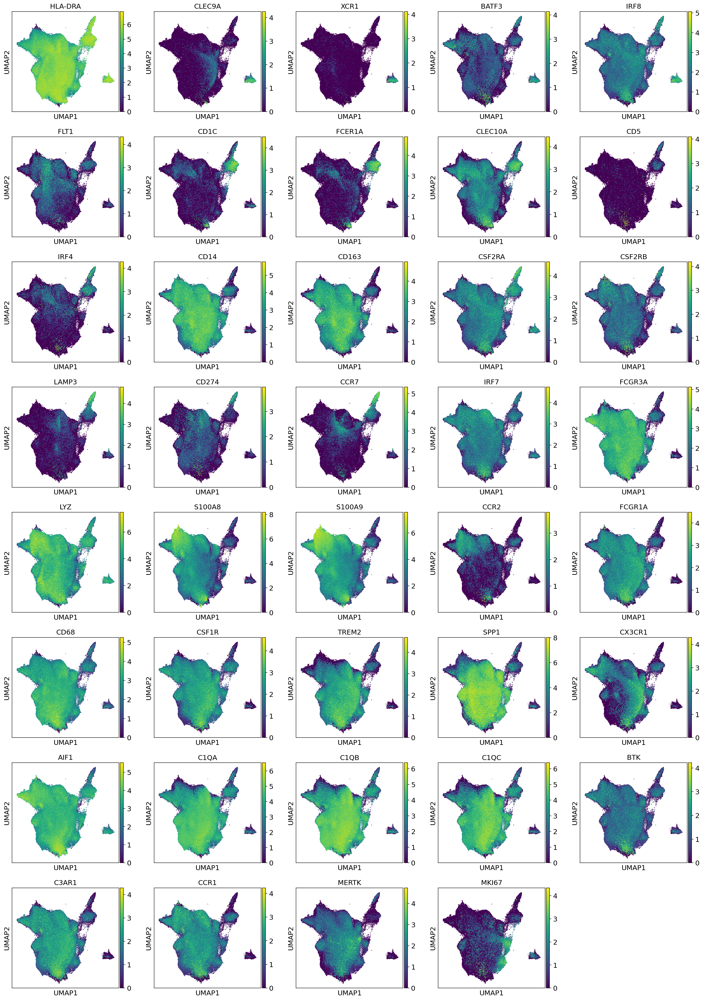

In [39]:
#plot DC/mono/mac marker genes on UMAP 
sc.pl.umap(
    data,
    color=broad_markers,
    ncols=5,
    size=5,
)


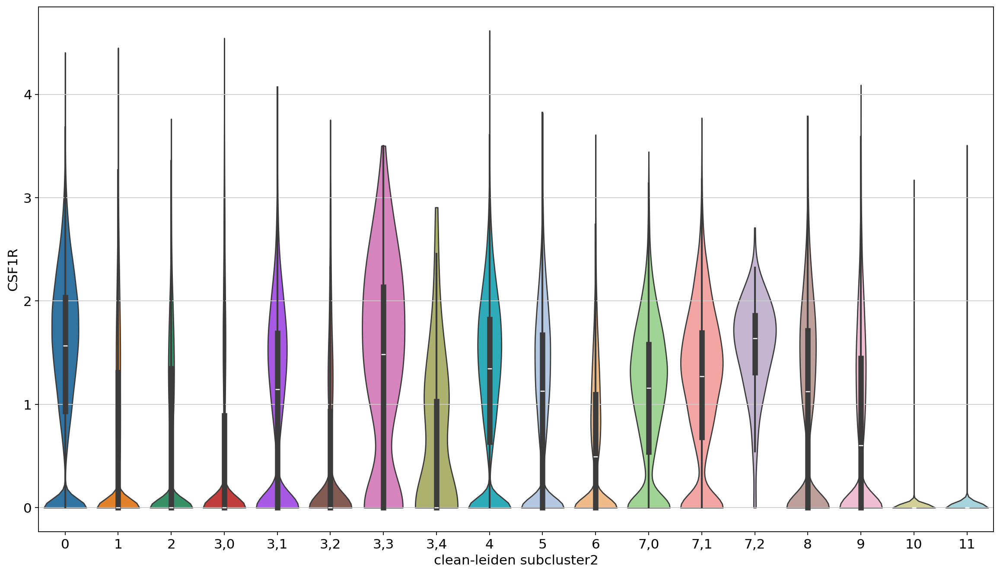

In [40]:
#make violin plot of CSF1R
with rc_context({"figure.figsize": (14, 10)}):
    sc.pl.violin(data, ["CSF1R"], 
                 groupby="clean-leiden_subcluster2",
                 stripplot=False, #remove internal dots
                 inner="box", #adds boxplot inside violins
                 )

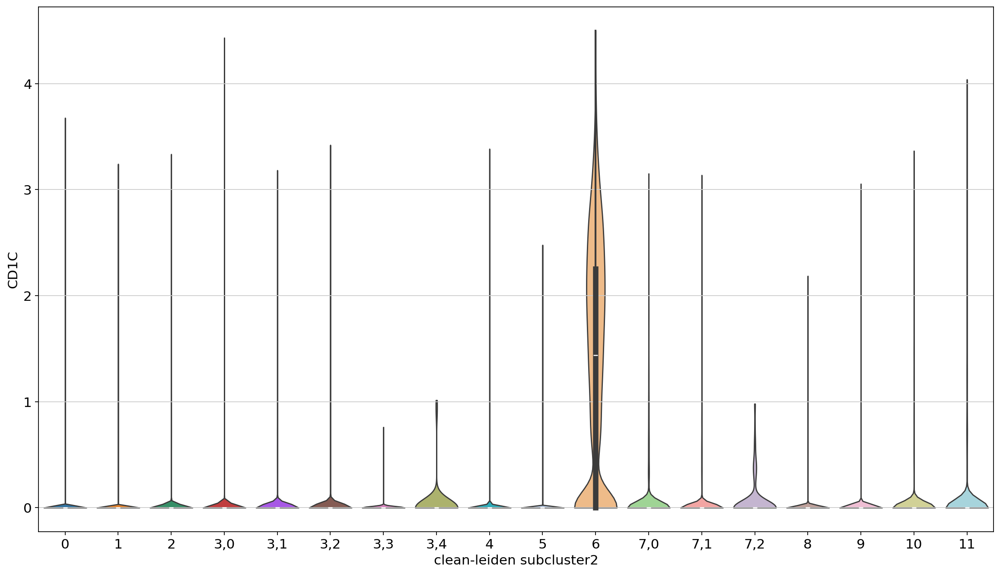

In [41]:
#make violin plot of CD1c
with rc_context({"figure.figsize": (14, 10)}):
    sc.pl.violin(data, ["CD1C"], 
                 groupby="clean-leiden_subcluster2",
                 stripplot=False, #remove internal dots
                 inner="box", #adds boxplot inside violins
                 )

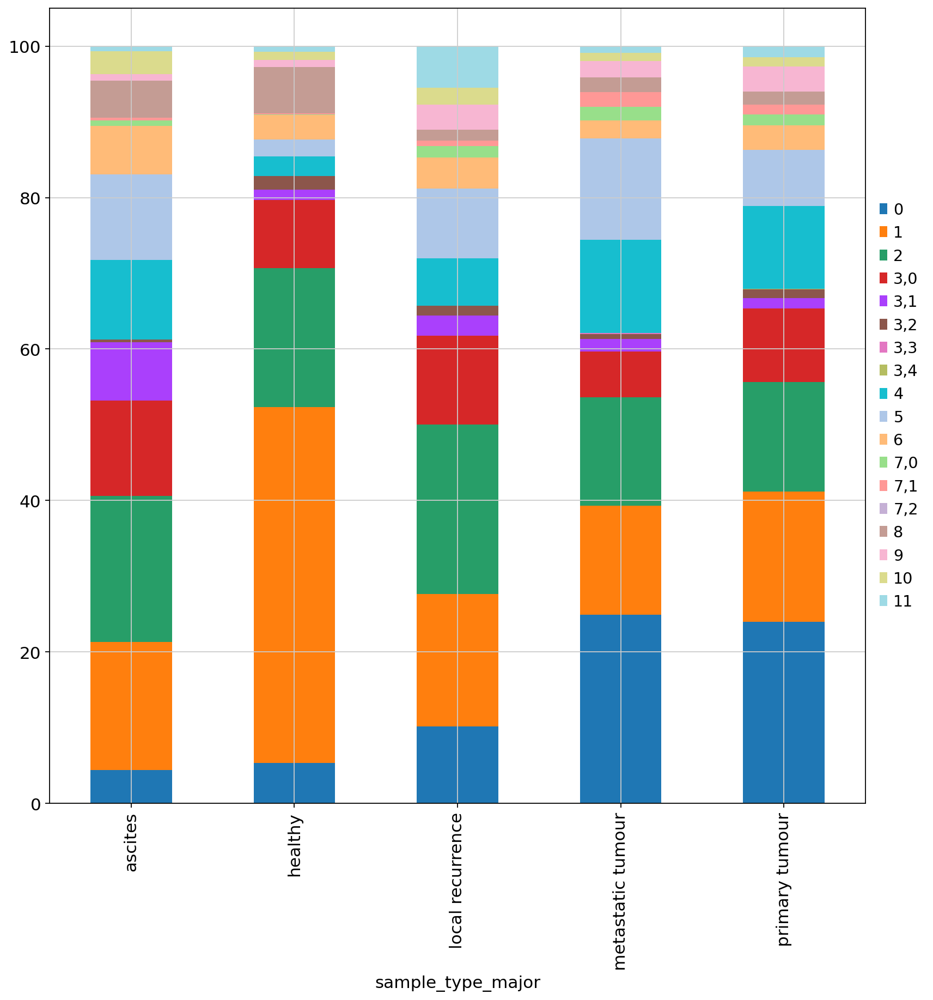

In [42]:
#### Creating a stacked bar
pd.crosstab(data.obs["sample_type_major"], data.obs["clean-leiden_subcluster2"]).apply(
    lambda r: r / r.sum() * 100, axis=1
).plot.bar(stacked=True, figsize=(12,12))
plt.legend(bbox_to_anchor=(1, 0.5), loc="center left", frameon=False)

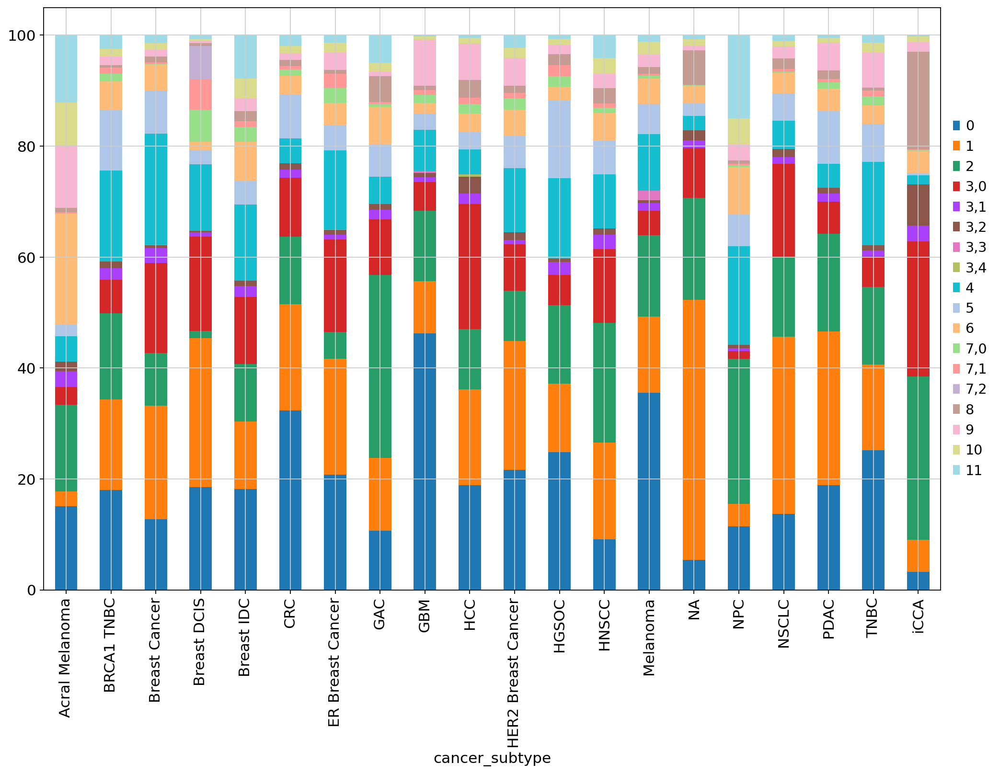

In [43]:
#### Creating a stacked bar
pd.crosstab(data.obs["cancer_subtype"], data.obs["clean-leiden_subcluster2"]).apply(
    lambda r: r / r.sum() * 100, axis=1
).plot.bar(stacked=True, figsize=(15,10))
plt.legend(bbox_to_anchor=(1, 0.5), loc="center left", frameon=False)


In [44]:
#table: 

# Creating the crosstab with percentages
table = pd.crosstab(data.obs["cancer_subtype"], data.obs["clean-leiden_subcluster2"]).apply(
    lambda r: r / r.sum() * 100, axis=1)

In [45]:
table

clean-leiden_subcluster2,0,1,2,"3,0","3,1","3,2","3,3","3,4",4,5,6,"7,0","7,1","7,2",8,9,10,11
cancer_subtype,,,,,,,,,,,,,,,,,,
Acral Melanoma,15.031315,2.713987,15.657620,3.131524,2.922756,1.670146,0.000000,0.000000,4.592902,2.087683,20.041754,0.000000,0.208768,0.000000,0.835073,11.273486,7.724426,12.108559
BRCA1 TNBC,18.045727,16.303756,15.541644,6.015242,2.041372,1.252041,0.000000,0.000000,16.385411,10.914535,5.144257,1.415351,1.088732,0.000000,0.489929,1.524224,1.415351,2.422428
Breast Cancer,12.724307,20.473083,9.502447,16.231648,2.691680,0.530179,0.040783,0.000000,20.024470,7.789560,4.690049,0.122349,0.326264,0.000000,1.019576,1.182708,1.182708,1.468189
Breast DCIS,18.534299,26.842778,1.278228,17.043034,0.766937,0.298253,0.000000,0.000000,11.930124,2.513847,1.576481,5.752024,5.581594,5.922454,0.511291,0.426076,0.383468,0.639114
Breast IDC,18.213177,12.142118,10.348396,12.107623,2.000690,0.896861,0.034495,0.000000,13.763367,4.208348,7.105899,2.656088,1.034840,0.000000,1.759227,2.380131,3.552949,7.795792
CRC,32.353699,19.180201,12.193864,10.569734,1.469451,1.134313,0.000000,0.000000,4.485692,7.837071,3.480278,1.134313,0.567156,0.025780,1.160093,1.160093,1.288992,1.959268
ER Breast Cancer,20.784766,20.877092,4.824005,16.722447,0.854010,0.854010,0.057703,0.000000,14.264282,4.443162,4.120023,2.642816,2.573572,0.000000,0.715522,3.208309,1.673399,1.384882
GAC,10.628019,13.181504,32.953761,10.006901,1.759834,1.035197,0.000000,0.000000,4.934438,5.797101,6.763285,0.552105,0.310559,0.000000,4.727398,0.828157,1.587302,4.934438
GBM,46.245222,9.429580,12.655101,5.186710,0.885034,0.743899,0.367539,0.000000,7.397824,3.002058,1.896501,1.428991,0.829168,0.002940,0.776242,8.306380,0.611585,0.235225


#### add draft broad annotations:

In [57]:
data.obs["clean_labels_v1"] = data.obs["clean-leiden_subcluster2"].map(
    {
        "0": "tissue-resident macrophage",
        "1": "tissue-resident macrophage",
        "2": "monocytes",
        "3,0": "monocyte-derived macrophage",
        "3,1": "monocytes",
        "3,2": "monocyte-derived macrophage",
        "3,3": "tissue-resident macrophage",
        "3,4": "tissue-resident macrophage",
        "4": "tissue-resident macrophage",
        "5": "tissue-resident macrophage",
        "6": "cDC2",
        "7,0": "tissue-resident macrophage",
        "7,1": "tissue-resident macrophage",
        "7,2": "tissue-resident macrophage",
        "8": "monocyte-derived macrophage",
        "9": "monocyte-derived macrophage",
        "10": "cDC1",
        "11": "mregDC",
    }
)

### Overlay gene sets

In [9]:
#define gene sets
YS_sig = ['PF4','MMP9','E130306D19RIK','CADM1','IRAK1','SH3YL1','DNAJB6','EPCAM','CHR10:117021051-117038683_F','ECD','PFKP','FABP4','MS4A7','DCAKD','GPS1','TRNAU1AP','AGPAT3','DNAJB6','CHR4:145000941-145148666_F','GPS1','SAE1','FOSB','CHR8:91569369-91594119_R','HOXC4','FOLR2','TUBB2A-PS2','GPS1','CHR8:91569369-91594119_R','BAZ1B','OST4','CHR8:72076364-72077503_R','PTPRA','PLOD1','4930555G01RIK','PHF5A','CHR17:95158347-95160942_F','CHR8:48476637-48492537_F','CHR14:44284425-44300475_F','TC1660977','NMD3','PLAU','BTF3L4','CHR17:33995525-34028025_F','CDK2','FCRLS','1110017F19RIK','MAPK9','GDPD1','CHR2:155269145-155303251_F','FBXO30','TRNAU1AP','MRC1','FAM98B','AV575311','CHR17:95158347-95160942_F','CCDC18','ANLN','CTBP2','ACSM3','S1PR1','PXDN','MAN1A','COX6A1','SLC43A3','CCDC47','FAM178A','TNS3','NAP102625-1','PLEKHG5','NDUFS4','CHR10:14888108-14978308_R','UBE2Z','B3GALNT1','TBC1D19','AK007267','MRTO4','TRAIP','CEP55','CHR10:117021051-117038683_R','CHR10:117021051-117038683_R','UTP20','CHR2:108382077-108441137_R','STMN1','4930534B04RIK','CHR14:44146705-44149729_R','CHR10:117021051-117038683_F','STAB1','SMARCAD1','CHR18:78190463-78235438_R','NAP111768-1','CHR5:121768672-121772658_F','CTSB','MAN2B2','PTN','SLC30A7','LHFPL2','CXCL2','RALGDS','CHR4:133368314-133380210_F','CHR8:19682258-19700836_F','A_55_P2169539','CHR7:99879368-99889978_F','ABCB8','NDRG3','PEG3','NUF2','SENP5','SLC35D1','AI462493','RILPL1','CHR2:108382077-108441137_R','NDUFV1','AHSA1']
HSC_sig = ['TTLL3','FAM55D','6330418K02RIK','GDA','GPR35','IFITM6','XDH','8430419L09RIK','PIRA11','CD74','LOC100038947','MBP','S100A8','GM10693','F12','PID1','A_55_P2184200','CCR2','LILRA6','ETOHI1','PNRC1','ARHGEF37','UBP1','TREML4','VMN1R174','POLR1E','ART2A-PS','CYTIP','TEAD1','KLRA2','GZF1','PLAC8','ENSMUST00000103299','RASGRP4','KLF13','PLBD1','CHR2:128249388-128250301_F','PIRA6','MPG','DENND1C','SMPDL3A','DGKG','ENSMUST00000050386','LIME1','HIST1H2BP','1700112J16RIK','OASL2','PTHLH','AHNAK','CHR3:79069438-79073704_R','A_55_P2050722','KYNU','RAC2','TCTEX1D2','SELL','KLRA9','CHR10:66559716-66647841_R']

In [48]:
#score genes
sc.tl.score_genes(data, YS_sig, score_name='YS_score')

       'CHR4:145000941-145148666_F', 'CHR8:91569369-91594119_R', 'TUBB2A-PS2',
       'CHR8:72076364-72077503_R', '4930555G01RIK',
       'CHR17:95158347-95160942_F', 'CHR8:48476637-48492537_F',
       'CHR14:44284425-44300475_F', 'TC1660977', 'CHR17:33995525-34028025_F',
       'FCRLS', '1110017F19RIK', 'CHR2:155269145-155303251_F', 'AV575311',
       'MAN1A', 'FAM178A', 'NAP102625-1', 'CHR10:14888108-14978308_R',
       'AK007267', 'CHR10:117021051-117038683_R', 'CHR2:108382077-108441137_R',
       '4930534B04RIK', 'CHR14:44146705-44149729_R',
       'CHR18:78190463-78235438_R', 'NAP111768-1',
       'CHR5:121768672-121772658_F', 'CHR4:133368314-133380210_F',
       'CHR8:19682258-19700836_F', 'A_55_P2169539', 'CHR7:99879368-99889978_F',
       'PEG3', 'AI462493'],
      dtype='object')


In [49]:
sc.tl.score_genes(data, HSC_sig,score_name='HSC_score')

       'LOC100038947', 'GM10693', 'A_55_P2184200', 'ETOHI1', 'TREML4',
       'VMN1R174', 'ART2A-PS', 'KLRA2', 'ENSMUST00000103299',
       'CHR2:128249388-128250301_F', 'PIRA6', 'ENSMUST00000050386',
       'HIST1H2BP', '1700112J16RIK', 'OASL2', 'CHR3:79069438-79073704_R',
       'A_55_P2050722', 'KLRA9', 'CHR10:66559716-66647841_R'],
      dtype='object')


In [10]:
colour_vars = ["YS_score","HSC_score","clean_labels_v1"]

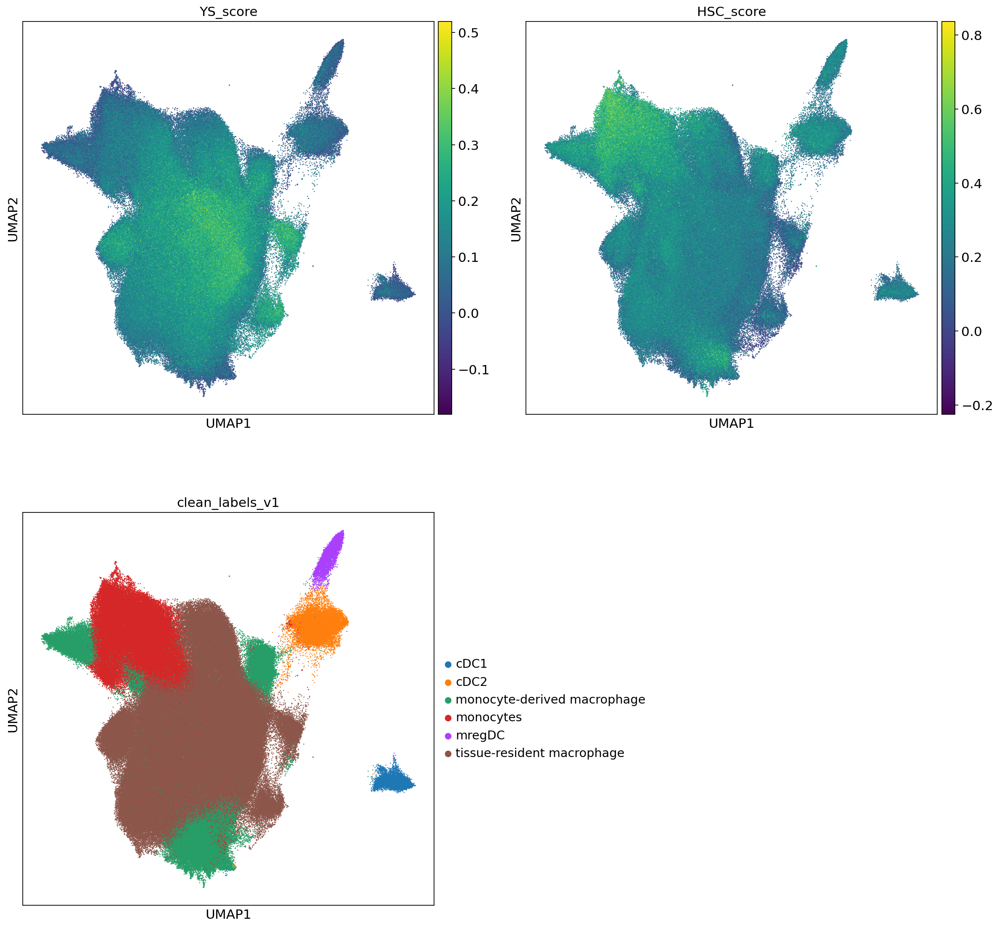

In [11]:
#plotting 
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color=colour_vars, ncols=2, size=5)

In [8]:
import numpy as np
import seaborn as sns

In [12]:
# Calculate the mean scores for each cluster
cluster_labels = data.obs['clean_labels_v1']
ys_scores = data.obs['YS_score']
hsc_scores = data.obs['HSC_score']

In [13]:
# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'YS_score': ys_scores.groupby(cluster_labels).mean(),
    'HSC_score': hsc_scores.groupby(cluster_labels).mean()
})

/scratch/temp/11099731/ipykernel_184567/3034877435.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/scratch/temp/11099731/ipykernel_184567/3034877435.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


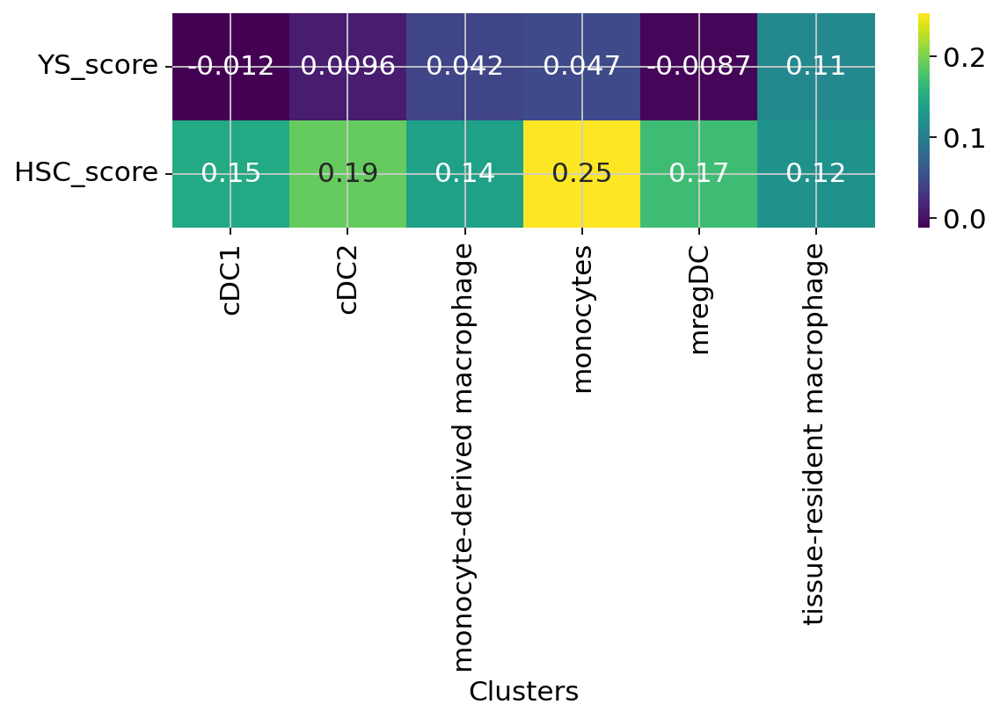

In [14]:
# Plot the heatmap
plt.figure(figsize=(8, 2))
sns.heatmap(scores_df.T, cmap='viridis', annot=True, cbar=True)
plt.xlabel('Clusters')
plt.show()

In [15]:
# Calculate the mean scores for each cluster
cluster_labels = data.obs['clean-leiden_subcluster2']
ys_scores = data.obs['YS_score']
hsc_scores = data.obs['HSC_score']

In [16]:
# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'YS_score': ys_scores.groupby(cluster_labels).mean(),
    'HSC_score': hsc_scores.groupby(cluster_labels).mean()
})

/scratch/temp/11099731/ipykernel_184567/3034877435.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
/scratch/temp/11099731/ipykernel_184567/3034877435.py:4: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


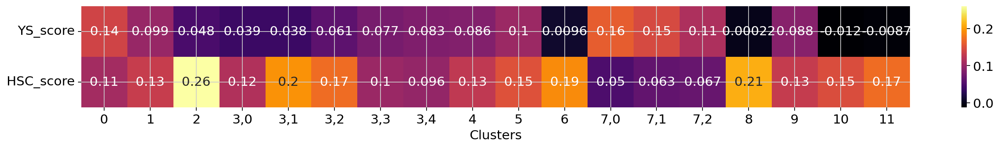

In [25]:
# Plot the heatmap
plt.figure(figsize=(20, 2))
sns.heatmap(scores_df.T, cmap='inferno', annot=True)
plt.xlabel('Clusters')
plt.show()

### Overlay my tumour uptake signature: 

In [26]:
#make an object with my sigs - see excel file Nikita-mregDC_DEG_summary on i drive
Uptake_sig = ["CCL22","IL4I1","SIRPA","CCR7","CHST11","GPR157","RGS1","BIRC3","TRAF1","CSF2RA","TBC1D13","LAMP3","MREG","PPP1R14A","SPRED2","CD83","TXN","MOB3A","NFKB1","TBC1D4","CDK2","WFDC21P","ARAP2","ZER1","ACSL1","SPINT2","SQSTM1","TBC1D8","JAG1","AC073508.3","BATF","ETV3","BCL2","KIF2A","FSCN1","TNFAIP3","CCDC28B","NR4A3","CYTIP","PLEK","FOXO1","TOMM34","TRAFD1","PPP1R16B","CXCR4","CD40","ENTPD7","CDKN1A","BID","MARCKS","DUSP5","MAP4K4","BCL2L1","ISG20","RNF145","RNF121","GPR132","RASGEF1B","CYRIA","RAB10","CERS6","IL1R1","STK4","CLEC2D","AL390719.1","ZBTB38","IFNGR2","CD274","SLC41A2","NRP2","ANKRD33B","GPR183","POGLUT1","ADORA2A","JADE3","KHDRBS3","CTNNB1","SLCO5A1","NFKB2","RGS2","SEC61B","ZNRF1","RELB","C12orf45","IRF2","EPOP","MXD1","RAB5B","PADI2","DRAM1","MTMR4","EEF2K","GCNT2","RAPH1","BCL2A1","SEC23B","PIM3","ANTXR2","ABTB2","TMEM200A"]    

In [73]:
#score genes
sc.tl.score_genes(data, Uptake_sig, score_name='Uptake_score')

In [27]:
colour_vars = ["Uptake_score","clean_labels_v1"]

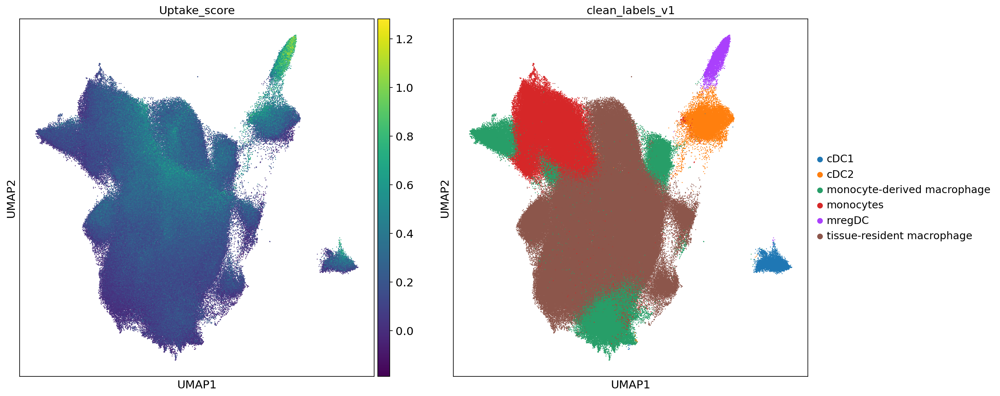

In [28]:
#plotting 
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color=colour_vars, ncols=2, size=5)

In [29]:
colour_vars = ["Uptake_score","clean-leiden_subcluster2"]

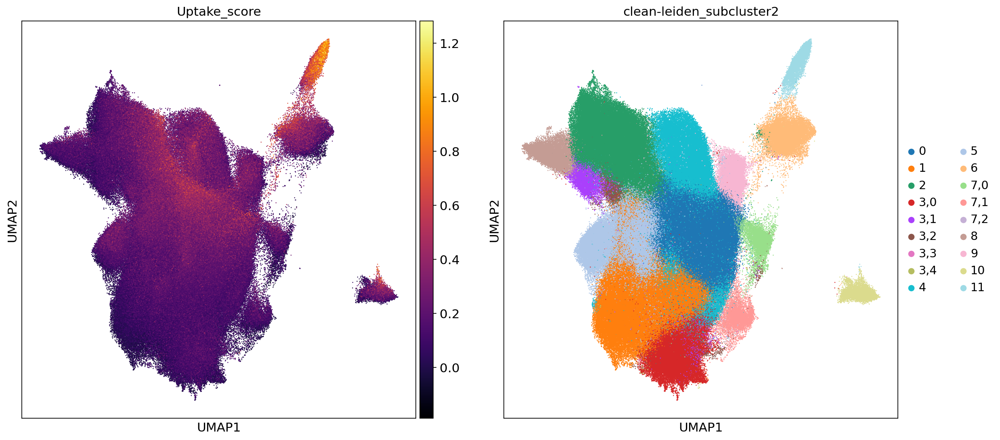

In [31]:
#plotting 
with plt.rc_context({"figure.figsize": (8, 8)}):
    sc.pl.umap(data, color=colour_vars, ncols=2, size=5, color_map="inferno")

In [23]:
import numpy as np
import seaborn as sns

In [32]:
# Calculate the mean scores for each cluster
cluster_labels = data.obs['clean_labels_v1']
uptake_scores = data.obs['Uptake_score']

In [33]:
# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'Uptake_score': uptake_scores.groupby(cluster_labels).mean(),
})

/scratch/temp/11099731/ipykernel_184567/2087912047.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


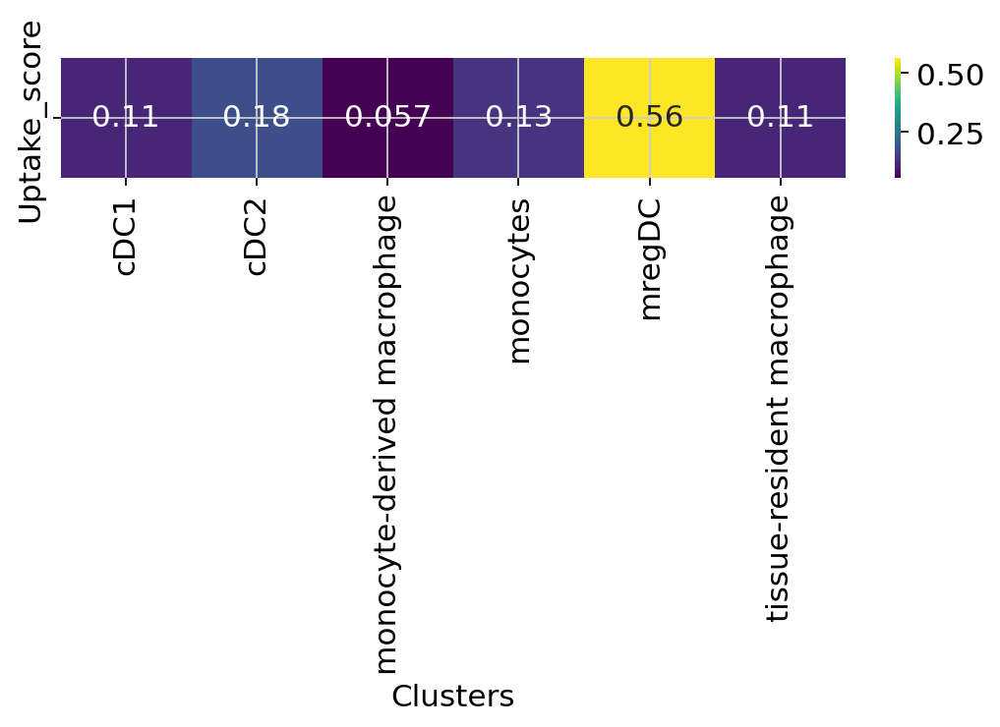

In [34]:
# Plot the heatmap
plt.figure(figsize=(8, 1))
sns.heatmap(scores_df.T, cmap='viridis', annot=True, cbar=True)
plt.xlabel('Clusters')
plt.show()

In [35]:
# Calculate the mean scores for each cluster
cluster_labels = data.obs['clean-leiden_subcluster2']
uptake_scores = data.obs['Uptake_score']

In [36]:
# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'Uptake_score': uptake_scores.groupby(cluster_labels).mean(),
})

/scratch/temp/11099731/ipykernel_184567/2087912047.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


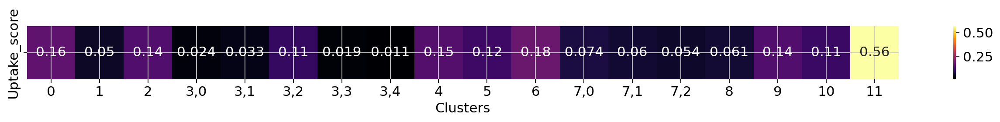

In [39]:
# Plot the heatmap
plt.figure(figsize=(20, 1))
sns.heatmap(scores_df.T, cmap='inferno', annot=True, cbar=True)
plt.xlabel('Clusters')
plt.show()

### split by cancer subtype

In [106]:
# Calculate the mean scores for each cluster
cluster_labels = data.obs['clean_labels_v1']
uptake_scores = data.obs['Uptake_score']
cancer_subtype = data.obs['cancer_subtype']

In [107]:
# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'Uptake_score': uptake_scores,
    'cluster': cluster_labels,
    'cancer_subtype': cancer_subtype
})

mean_scores_df = scores_df.groupby(['cancer_subtype', 'cluster']).mean().unstack()
mean_scores_df = mean_scores_df.T

/scratch/temp/11099731/ipykernel_184567/50111509.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


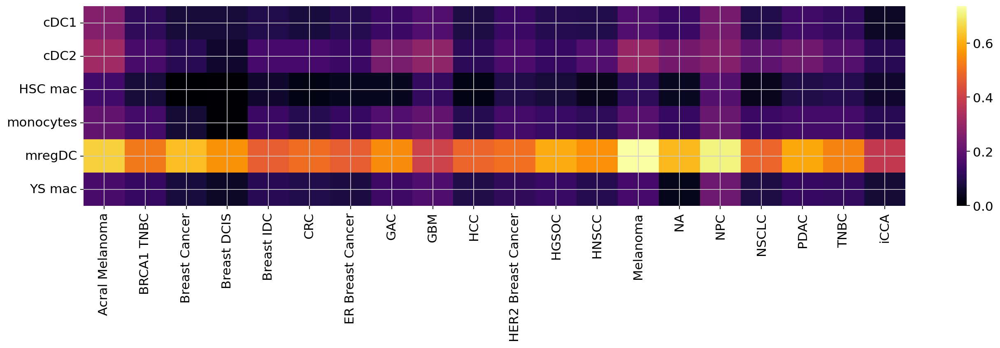

In [114]:
# Plot the heatmap
plt.figure(figsize=(20, 4))
ax = sns.heatmap(mean_scores_df, cmap='inferno')
ax.set_yticklabels(['cDC1', 'cDC2', 'HSC mac','monocytes','mregDC','YS mac'], rotation=0)  # Change the labels and their rotation
plt.xlabel('')
plt.ylabel('')
plt.show()


### make figure for poster showing sig for different cancer types

In [7]:
# make an object without healthy tissue 
disease = data[~data.obs["cancer_subtype"].isin(["NA"])]

In [8]:
disease

View of AnnData object with n_obs × n_vars = 434431 × 1270
    obs: 'nCount_RNA', 'nFeature_RNA', 'sample_type', 'cancer_type', 'patient_id', 'sample_id', 'percent.mt', 'site', 'sample_type_major', 'cancer_subtype', 'integration_id', 'ident', 'dataset_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'S_score', 'G2M_score', 'keep_or_remove', 'leiden', 'celltype', 'leiden_DC', 'leiden_DC_v2', 'exclude_annots', 'leiden_M', 'clean-leiden_subcluster', 'clean-leiden_subcluster2', 'clean_labels_v1', 'YS_score', 'HSC_score', 'CD5nDC2_up_vDC3_score', 'DC3_up_vCD5nDC2_score', 'CD5pDC2_up_vDC3_score', 'DC3_up_vCD5pDC2_score', 'DC3_up_vMono_score', 'Mono_up_vDC3_score', 'Uptake_score', 'cancer_type_broad'
    var: 'name', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_

In [24]:
# Calculate the mean scores for each cluster
cluster_labels = disease.obs['clean_labels_v1']
uptake_scores = disease.obs['Uptake_score']
cancer_subtype = disease.obs['cancer_type_broad']

In [25]:
# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'Uptake_score': uptake_scores,
    'cluster': cluster_labels,
    'cancer_subtype': cancer_subtype
})

mean_scores_df = scores_df.groupby(['cancer_subtype', 'cluster']).mean().unstack()
mean_scores_df = mean_scores_df.T

/scratch/temp/11116091/ipykernel_2722812/50111509.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


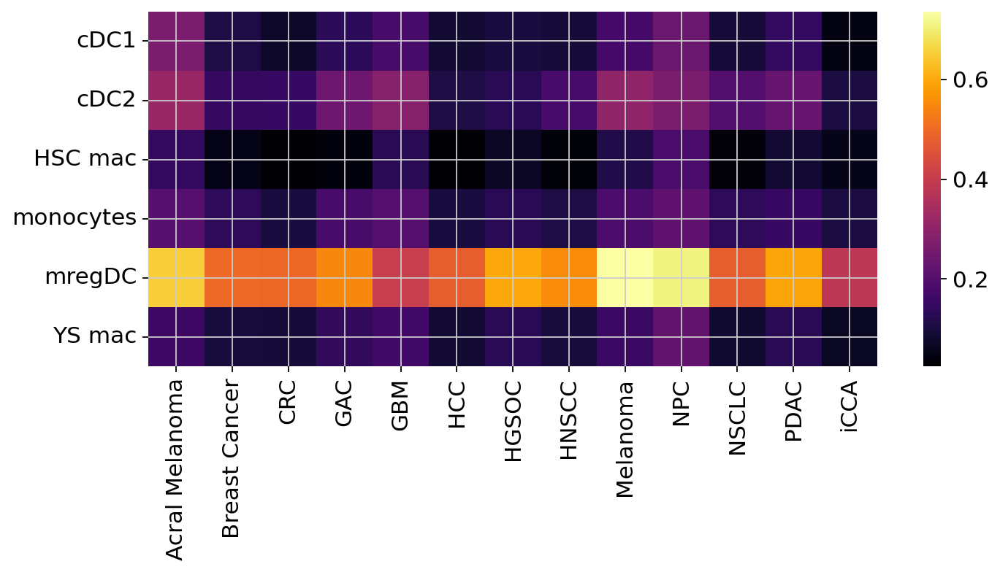

In [26]:
# Plot the heatmap
plt.figure(figsize=(10, 4))
ax = sns.heatmap(mean_scores_df, cmap='inferno')
ax.set_yticklabels(['cDC1', 'cDC2', 'HSC mac','monocytes','mregDC','YS mac'], rotation=0)  # Change the labels and their rotation
plt.xlabel('')
plt.ylabel('')
plt.show()

/scratch/temp/11103320/ipykernel_94542/2395366686.py:13: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


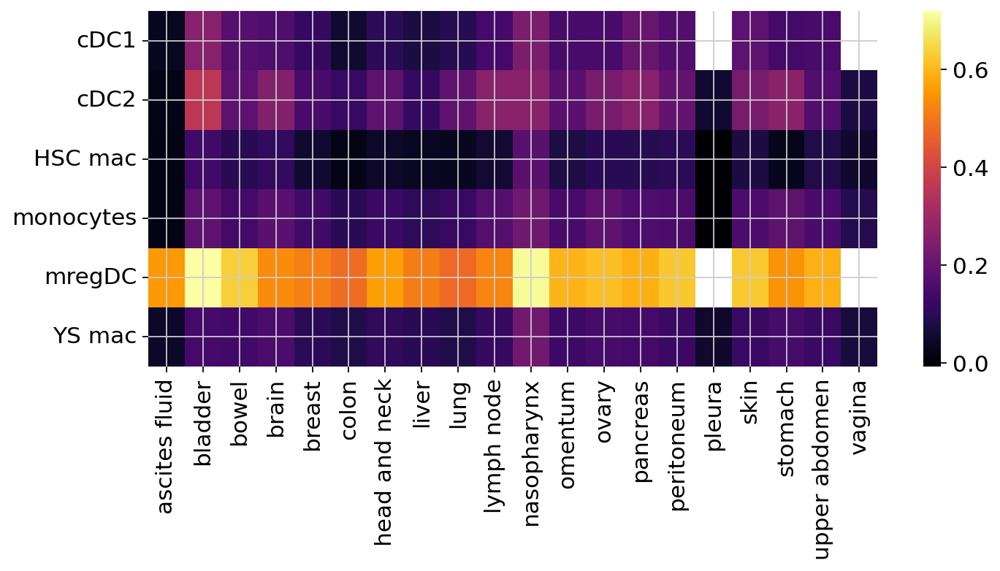

In [40]:
# Calculate the mean scores for each cluster
cluster_labels = disease.obs['clean_labels_v1']
uptake_scores = disease.obs['Uptake_score']
cancer_subtype = disease.obs['site']

# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'Uptake_score': uptake_scores,
    'cluster': cluster_labels,
    'cancer_subtype': cancer_subtype
})

mean_scores_df = scores_df.groupby(['cancer_subtype', 'cluster']).mean().unstack()
mean_scores_df = mean_scores_df.T

# Plot the heatmap
plt.figure(figsize=(10, 4))
ax = sns.heatmap(mean_scores_df, cmap='inferno')
ax.set_yticklabels(['cDC1', 'cDC2', 'HSC mac','monocytes','mregDC','YS mac'], rotation=0)  # Change the labels and their rotation
plt.xlabel('')
plt.ylabel('')
plt.show()

### By cluster

In [80]:
# Calculate the mean scores for each cluster
cluster_labels = data.obs['clean-leiden_subcluster2']
uptake_scores = data.obs['Uptake_score']
cancer_subtype = data.obs['cancer_subtype']

In [81]:
# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'Uptake_score': uptake_scores,
    'cluster': cluster_labels,
    'cancer_subtype': cancer_subtype
})

mean_scores_df = scores_df.groupby(['cancer_subtype', 'cluster']).mean().unstack()
mean_scores_df = mean_scores_df.T

/scratch/temp/11099731/ipykernel_184567/50111509.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


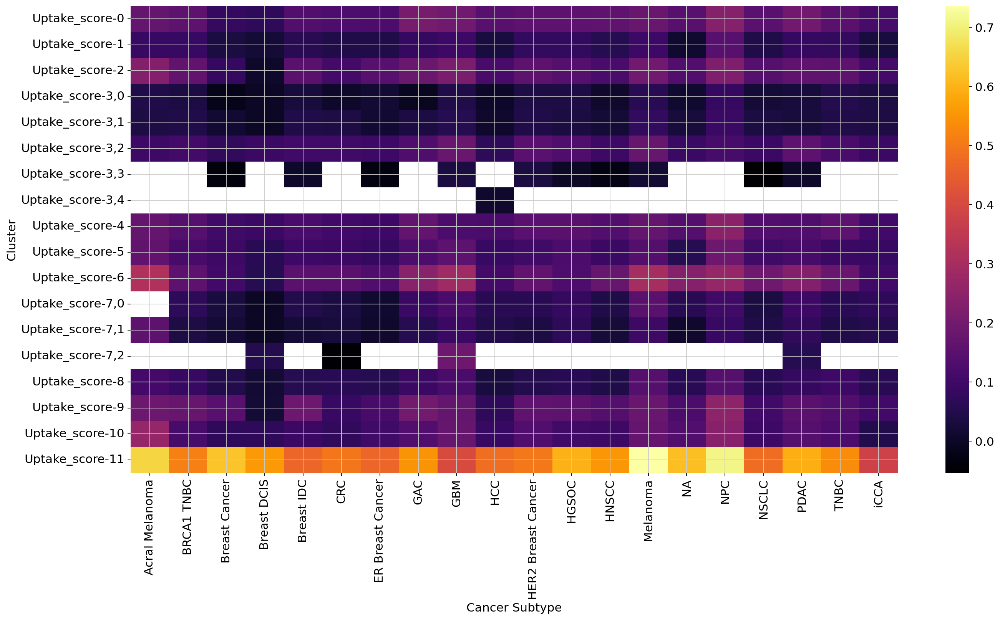

In [83]:
# Plot the heatmap
plt.figure(figsize=(20, 10))
sns.heatmap(mean_scores_df, cmap='inferno', linewidths=0)
plt.xlabel('Cancer Subtype')
plt.ylabel('Cluster')
plt.show()

In [92]:
# Calculate the mean scores for each cluster
cluster_labels = data.obs['clean_labels_v1']
uptake_scores = data.obs['Uptake_score']
cancer_subtype = data.obs['sample_type_major']

In [93]:
# Create a DataFrame with the mean scores per cluster
scores_df = pd.DataFrame({
    'Uptake_score': uptake_scores,
    'cluster': cluster_labels,
    'cancer_subtype': cancer_subtype
})

mean_scores_df = scores_df.groupby(['cancer_subtype', 'cluster']).mean().unstack()
mean_scores_df = mean_scores_df.T

/scratch/temp/11099731/ipykernel_184567/50111509.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.


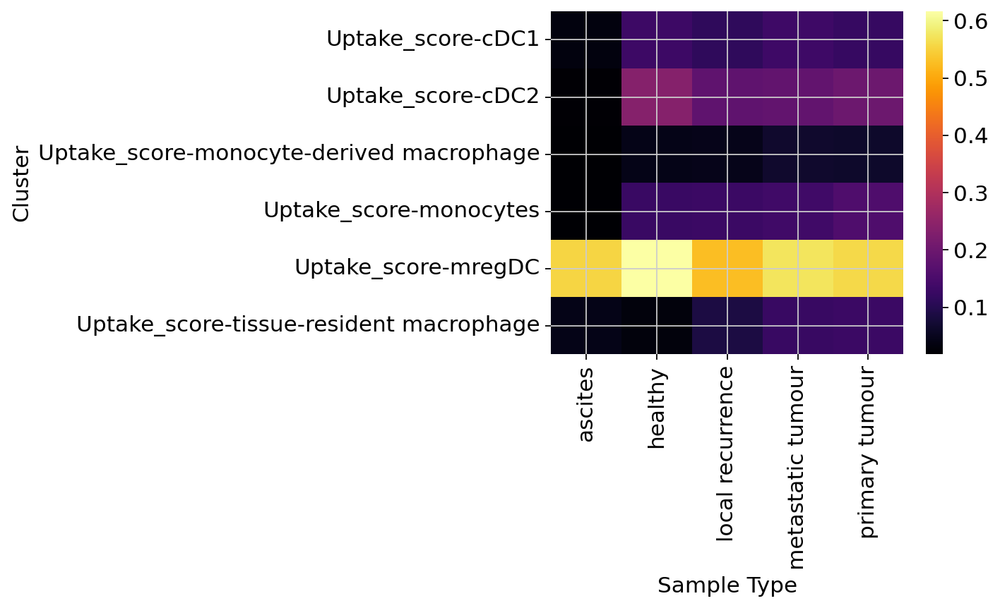

In [97]:
# Plot the heatmap
plt.figure(figsize=(5, 4))
sns.heatmap(mean_scores_df, cmap='inferno', linewidths=0)
plt.xlabel('Sample Type')
plt.ylabel('Cluster')
plt.show()

In [79]:
#export to use later
data.write_h5ad("NRclean_clustered.h5ad", compression="gzip")

### Getting stats for graph:

In [94]:
#tabulate number of cells per sample type/ site/ cancer type and export as csv
table = pd.crosstab(data.obs["cancer_subtype"], data.obs["sample_type_major"])

table.to_csv('table_cancer_subtype-v-sample_typev2.csv')

In [8]:
#tabulate number of cells per sample type/ site/ cancer type and export as csv
table = pd.crosstab(data.obs["site"], data.obs["sample_type_major"])

table.to_csv('table_site-v-sample_typev2.csv')

In [9]:
#tabulate number of cells per sample type/ site/ cancer type and export as csv
table = pd.crosstab(data.obs["dataset_id"], data.obs["sample_type_major"])

table.to_csv('table_dataset-v-sample_typev2.csv')

In [7]:
#tabulate number of cells per sample type/ site/ cancer type and export as csv
table = pd.crosstab(data.obs["integration_id"], data.obs["sample_type_major"])

table.to_csv('table_integration_id-v-sample_typev2.csv')

In [98]:
#count of number of unique integration_id's and dataset_id's

unique_integration_ids = data.obs['integration_id'].nunique()
unique_dataset_ids = data.obs['dataset_id'].nunique()
print(unique_integration_ids,unique_dataset_ids)

589 36
